In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls /content/drive/MyDrive/EEG_dataset/dataset

add_stim.mat		control_stim.mat  d7.mat		    sub-01_task-1_eeg.vmrk
adhd_d5.mat		d1.mat		  first_129_of_d3.mat	    sub-05_task_eeg.eeg
adhd_stim.mat		d2.mat		  last_1840_columnsNew.mat  sub-05_task_eeg.vhdr
adhd_test_data.mat	d3.mat		  last_1840_of_d5.mat	    sub-05_task_eeg.vmrk
adhd_train_data.mat	d4.mat		  readme.txt		    sub_name_stim.mat
chan.mat		d5.mat		  sub-01_task-1_eeg.eeg     transposed_combined_data.mat
combined_adhd_data.mat	d6.mat		  sub-01_task-1_eeg.vhdr    y_stim.mat


In [ ]:
import scipy.io
import os

# Directory containing the participant files
directory_path = '/content/drive/MyDrive/EEG_dataset/splitset'

# List all files in the directory
files_in_directory = os.listdir(directory_path)

# Filter out the files that contain 'train' in their name
train_files = [file for file in files_in_directory if 'train' in file]

# Print the count of files
print(f"Number of 'train' files: {len(train_files)}")

# Process the filtered train files
for train_file in train_files:
    file_path = os.path.join(directory_path, train_file)

    # Load the EEG data from the .mat file
    print(f"Loading file: {file_path}")
    eeg_data = scipy.io.loadmat(file_path)

    # Print the keys in the .mat file
    print(f"Keys in the file {train_file}: {list(eeg_data.keys())}")

    # Optionally, you can also look at the first few elements of the data to understand the structure
    # For example, you can print the content of the first key
    first_key = list(eeg_data.keys())[0]
    print(f"First key content for {first_key}: {eeg_data[first_key]}")

    print("-" * 50)


Number of 'train' files: 33
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/14_train.mat
Keys in the file 14_train.mat: ['__header__', '__version__', '__globals__', 'train_data']
First key content for __header__: b'MATLAB 5.0 MAT-file Platform: posix, Created on: Wed Dec 18 17:25:28 2024'
--------------------------------------------------
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/18_train.mat
Keys in the file 18_train.mat: ['__header__', '__version__', '__globals__', 'train_data']
First key content for __header__: b'MATLAB 5.0 MAT-file Platform: posix, Created on: Wed Dec 18 17:25:28 2024'
--------------------------------------------------
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/16_train.mat
Keys in the file 16_train.mat: ['__header__', '__version__', '__globals__', 'train_data']
First key content for __header__: b'MATLAB 5.0 MAT-file Platform: posix, Created on: Wed Dec 18 17:25:28 2024'
--------------------------------------------------
Loa

In [ ]:
import scipy.io
import os

# Directory containing the participant files
directory_path = '/content/drive/MyDrive/EEG_dataset/splitset'

# List all files in the directory
files_in_directory = os.listdir(directory_path)

# Filter out the files that contain 'train' in their name
train_files = [file for file in files_in_directory if 'train' in file]

# Print the count of files
print(f"Number of 'train' files: {len(train_files)}")

# Process the filtered train files
for train_file in train_files:
    file_path = os.path.join(directory_path, train_file)

    # Load the EEG data from the .mat file
    print(f"Loading file: {file_path}")
    eeg_data = scipy.io.loadmat(file_path)

    # Print the keys in the .mat file
    print(f"Keys in the file {train_file}: {list(eeg_data.keys())}")

    # Optionally, check the shape of each variable in the .mat file
    for key in eeg_data:
        # Check the type of the value
        data = eeg_data[key]

        # Print the shape of the data (if it's a numpy array)
        if isinstance(data, np.ndarray):
            print(f"Shape of data for key '{key}': {data.shape}")
        else:
            print(f"Data for key '{key}' is not a numpy array.")

    print("-" * 50)


Number of 'train' files: 33
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/14_train.mat
Keys in the file 14_train.mat: ['__header__', '__version__', '__globals__', 'train_data']
Data for key '__header__' is not a numpy array.
Data for key '__version__' is not a numpy array.
Data for key '__globals__' is not a numpy array.
Shape of data for key 'train_data': (385, 56, 238)
--------------------------------------------------
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/18_train.mat
Keys in the file 18_train.mat: ['__header__', '__version__', '__globals__', 'train_data']
Data for key '__header__' is not a numpy array.
Data for key '__version__' is not a numpy array.
Data for key '__globals__' is not a numpy array.
Shape of data for key 'train_data': (385, 56, 195)
--------------------------------------------------
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/16_train.mat
Keys in the file 16_train.mat: ['__header__', '__version__', '__globals__', 'train_

In [ ]:
 import numpy as np
import scipy.io
import os
from scipy.stats import zscore

# Directory containing the participant files
directory_path = '/content/drive/MyDrive/EEG_dataset/splitset'

# List all files in the directory
files_in_directory = os.listdir(directory_path)

# Filter out the files that contain 'train' in their name
train_files = [file for file in files_in_directory if 'train' in file]

# Print the count of files
print(f"Number of 'train' files: {len(train_files)}")

# Function to extract P300 features (latency and amplitude)
def extract_p300_features(eeg_data, selected_channels=[24, 27], fs=256, p300_window=(300, 600)):
    """
    Extract P300 features (latency and amplitude) from selected channels and averaged signal.

    eeg_data: 3D numpy array (n_timepoints, n_channels, n_trials)
    selected_channels: List of channels (1-based index)
    fs: Sampling rate (Hz)
    p300_window: Time window for extracting P300 peak (ms)

    Returns: Latencies and Amplitudes for each trial
    """
    # Convert from 1-based index to 0-based index
    selected_channels = [ch - 1 for ch in selected_channels]

    # Convert P300 window from ms to sample indices
    start_sample = int(p300_window[0] / 1000 * fs)  # 300 ms -> samples
    end_sample = int(p300_window[1] / 1000 * fs)  # 600 ms -> samples

    latencies = []
    amplitudes = []

    # Loop through each trial
    n_trials = eeg_data.shape[2]
    for trial_idx in range(n_trials):
        # Average the signals across selected channels (24, 27)
        averaged_signal = np.mean(eeg_data[:, selected_channels, trial_idx], axis=1)

        # Extract the P300 window from the averaged signal
        p300_signal = averaged_signal[start_sample:end_sample]

        # Find the latency (time of the maximum peak in the P300 window)
        p300_peak_idx = np.argmax(p300_signal)
        latency = (p300_peak_idx + start_sample) / fs  # Convert sample index to time (seconds)

        # Amplitude (maximum value in the P300 window)
        amplitude = np.max(p300_signal)

        latencies.append(latency)
        amplitudes.append(amplitude)

    # Return latencies and amplitudes
    return np.array(latencies), np.array(amplitudes)

# Process the filtered train files
all_latencies = []
all_amplitudes = []

for train_file in train_files:
    file_path = os.path.join(directory_path, train_file)

    # Load the EEG data from the .mat file
    print(f"Loading file: {file_path}")
    eeg_data = scipy.io.loadmat(file_path)

    # Extract the EEG signal and the stimulus onset indices
    eeg_data = eeg_data['train_data']  # Adjust based on your actual key

    # Extract P300 features (latency and amplitude)
    latencies, amplitudes = extract_p300_features(eeg_data, selected_channels=[24, 27], fs=256)

    # Append to the global lists
    all_latencies.append(latencies)
    all_amplitudes.append(amplitudes)

# Combine all latencies and amplitudes from all participants/trials
all_latencies = np.concatenate(all_latencies)
all_amplitudes = np.concatenate(all_amplitudes)

# Normalize the features using Z-score
latencies_zscore = zscore(all_latencies)
amplitudes_zscore = zscore(all_amplitudes)

# Prepare the feature matrix (each row represents a trial)
feature_matrix = np.column_stack([latencies_zscore, amplitudes_zscore])

# Print the feature matrix for verification
print(f"Feature matrix shape: {feature_matrix.shape}")
print("Feature matrix (first few rows):")
print(feature_matrix[:5])


Number of 'train' files: 33
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/14_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/18_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/16_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/10_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/17_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/30_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/33_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/1_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/32_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/31_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/6_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/12_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/35_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/sp

In [ ]:
import numpy as np
import scipy.io
import os
from scipy.stats import zscore

# Directory containing the participant files
directory_path = '/content/drive/MyDrive/EEG_dataset/splitset'

# List all files in the directory
files_in_directory = os.listdir(directory_path)

# Filter out the files that contain 'train' in their name
train_files = [file for file in files_in_directory if 'train' in file]

# Print the count of files
print(f"Number of 'train' files: {len(train_files)}")

# Function to extract P300 features (latency and amplitude)
def extract_p300_features(eeg_data, selected_channels=[24, 27], fs=256, p300_window=(300, 600)):
    """
    Extract P300 features (latency and amplitude) from selected channels and averaged signal.

    eeg_data: 3D numpy array (n_timepoints, n_channels, n_trials)
    selected_channels: List of channels (1-based index)
    fs: Sampling rate (Hz)
    p300_window: Time window for extracting P300 peak (ms)

    Returns: Latencies and Amplitudes for each trial
    """
    # Convert from 1-based index to 0-based index
    selected_channels = [ch - 1 for ch in selected_channels]

    # Convert P300 window from ms to sample indices
    start_sample = int(p300_window[0] / 1000 * fs)  # 300 ms -> samples
    end_sample = int(p300_window[1] / 1000 * fs)  # 600 ms -> samples

    latencies = []
    amplitudes = []

    # Loop through each trial
    n_trials = eeg_data.shape[2]
    for trial_idx in range(n_trials):
        # Average the signals across selected channels
        averaged_signal = np.mean(eeg_data[:, selected_channels, trial_idx], axis=1)

        # Extract the P300 window from the averaged signal
        p300_signal = averaged_signal[start_sample:end_sample]

        # Find the latency (time of the maximum peak in the P300 window)
        p300_peak_idx = np.argmax(p300_signal)
        latency = (p300_peak_idx + start_sample) / fs  # Convert sample index to time (seconds)

        # Amplitude (maximum value in the P300 window)
        amplitude = np.max(p300_signal)

        latencies.append(latency)
        amplitudes.append(amplitude)

    # Return latencies and amplitudes
    return np.array(latencies), np.array(amplitudes)

# Process the filtered train files
all_latencies = []
all_amplitudes = []

for train_file in train_files:
    file_path = os.path.join(directory_path, train_file)

    # Load the EEG data from the .mat file
    print(f"Loading file: {file_path}")
    eeg_data = scipy.io.loadmat(file_path)

    # Extract the EEG signal and the stimulus onset indices
    eeg_data = eeg_data['train_data']  # Adjust based on your actual key

    # Select channels dynamically (example: [24, 27])
    selected_channels = [24, 27]  # You can change this list based on your desired channels

    # Extract P300 features (latency and amplitude)
    latencies, amplitudes = extract_p300_features(eeg_data, selected_channels=selected_channels, fs=256)

    # Append to the global lists
    all_latencies.append(latencies)
    all_amplitudes.append(amplitudes)

# Combine all latencies and amplitudes from all participants/trials
all_latencies = np.concatenate(all_latencies)
all_amplitudes = np.concatenate(all_amplitudes)

# Normalize the features using Z-score
latencies_zscore = zscore(all_latencies)
amplitudes_zscore = zscore(all_amplitudes)

# Prepare the feature matrix (each row represents a trial)
feature_matrix = np.column_stack([latencies_zscore, amplitudes_zscore])

# Print the feature matrix for verification
print(f"Feature matrix shape: {feature_matrix.shape}")
print("Feature matrix (first few rows):")
print(feature_matrix[:5])


Number of 'train' files: 33
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/14_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/18_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/16_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/10_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/17_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/30_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/33_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/1_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/32_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/31_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/6_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/12_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/35_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/sp

Silhouette Score: 0.38557172462306233
Davies-Bouldin Index: 0.8750343273869938


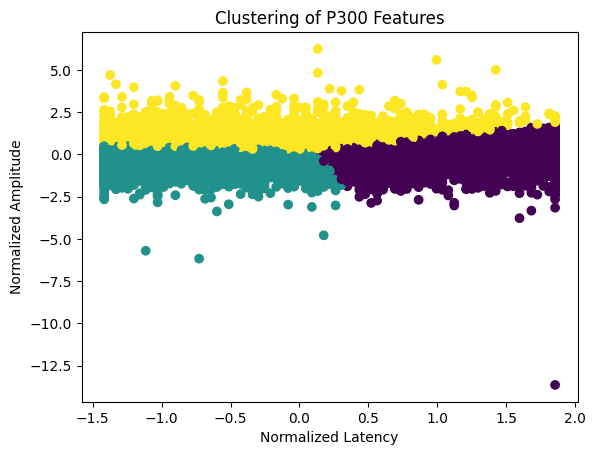

In [ ]:
# # Example: Applying KMeans clustering to the feature matrix
# from sklearn.cluster import KMeans

# # Number of clusters (you can choose based on domain knowledge or use methods like the Elbow Method)
# n_clusters = 3 # Example: 2 clusters for attention vs. no-attention

# # Perform clustering
# kmeans = KMeans(n_clusters=n_clusters, random_state=42)
# kmeans.fit(feature_matrix)

# # Get the cluster labels for each trial
# cluster_labels = kmeans.labels_

# # Optionally, you can evaluate the clustering quality
# from sklearn.metrics import silhouette_score, davies_bouldin_score

# silhouette = silhouette_score(feature_matrix, cluster_labels)
# davies_bouldin = davies_bouldin_score(feature_matrix, cluster_labels)

# print(f"Silhouette Score: {silhouette}")
# print(f"Davies-Bouldin Index: {davies_bouldin}")

# # Optionally, visualize the clusters
# import matplotlib.pyplot as plt

# plt.scatter(feature_matrix[:, 0], feature_matrix[:, 1], c=cluster_labels, cmap='viridis')
# plt.xlabel('Normalized Latency')
# plt.ylabel('Normalized Amplitude')
# plt.title('Clustering of P300 Features')
# plt.show()


EEG data shape: (385, 56, 257)


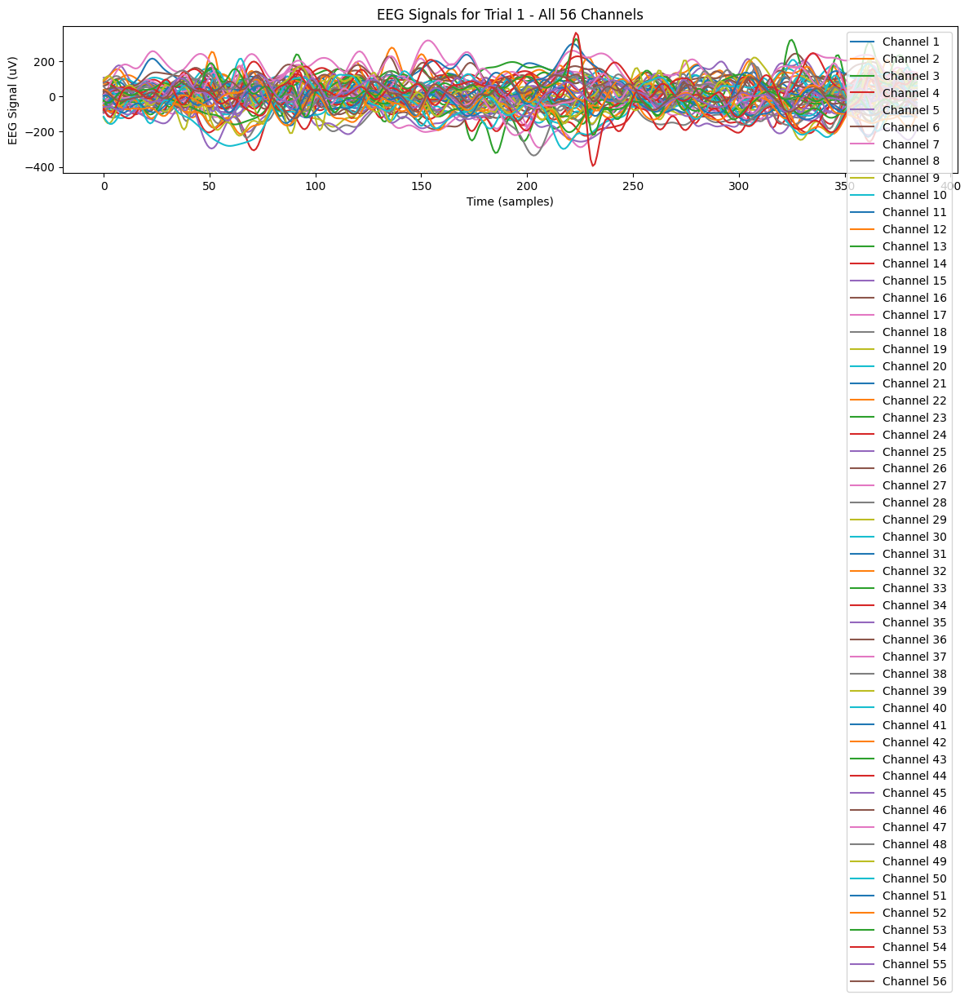

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.io

# Load the EEG data from the train1 file
file_path = '/content/drive/MyDrive/EEG_dataset/splitset/1_train.mat'  # Update with your actual path
eeg_data = scipy.io.loadmat(file_path)

# Extract the EEG data (adjust according to the structure of your .mat file)
eeg_data = eeg_data['train_data']  # Adjust based on your actual key in the .mat file

# Check the shape of the EEG data (should be (n_timepoints, n_channels, n_trials))
print(f"EEG data shape: {eeg_data.shape}")

# Select a specific trial (for example, trial 1)
trial_idx = 0  # Change to a specific trial number (0-based index)

# Set up the number of channels and time points
n_channels = eeg_data.shape[1]  # Number of EEG channels (56)
n_timepoints = eeg_data.shape[0]  # Number of time points per channel

# Plot the data for all 56 channels for a single trial
plt.figure(figsize=(12, 8))

for channel_idx in range(n_channels):
    # Extract data for the given channel and selected trial
    channel_data = eeg_data[:, channel_idx, trial_idx]

    # Plot the data for the current channel
    plt.plot(channel_data, label=f"Channel {channel_idx + 1}")

plt.title(f"EEG Signals for Trial {trial_idx + 1} - All 56 Channels")
plt.xlabel("Time (samples)")
plt.ylabel("EEG Signal (uV)")
plt.legend(loc="upper right")
plt.tight_layout()
plt.show()


EEG data shape: (385, 56, 257)


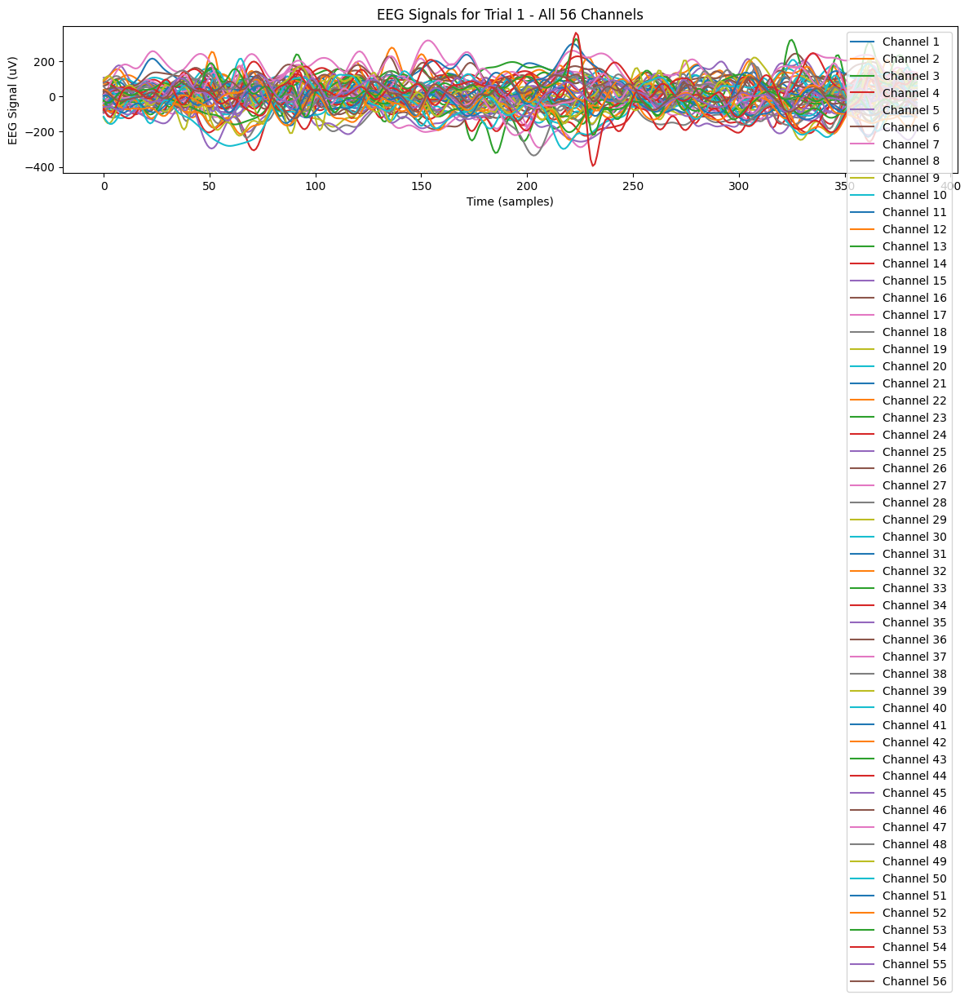

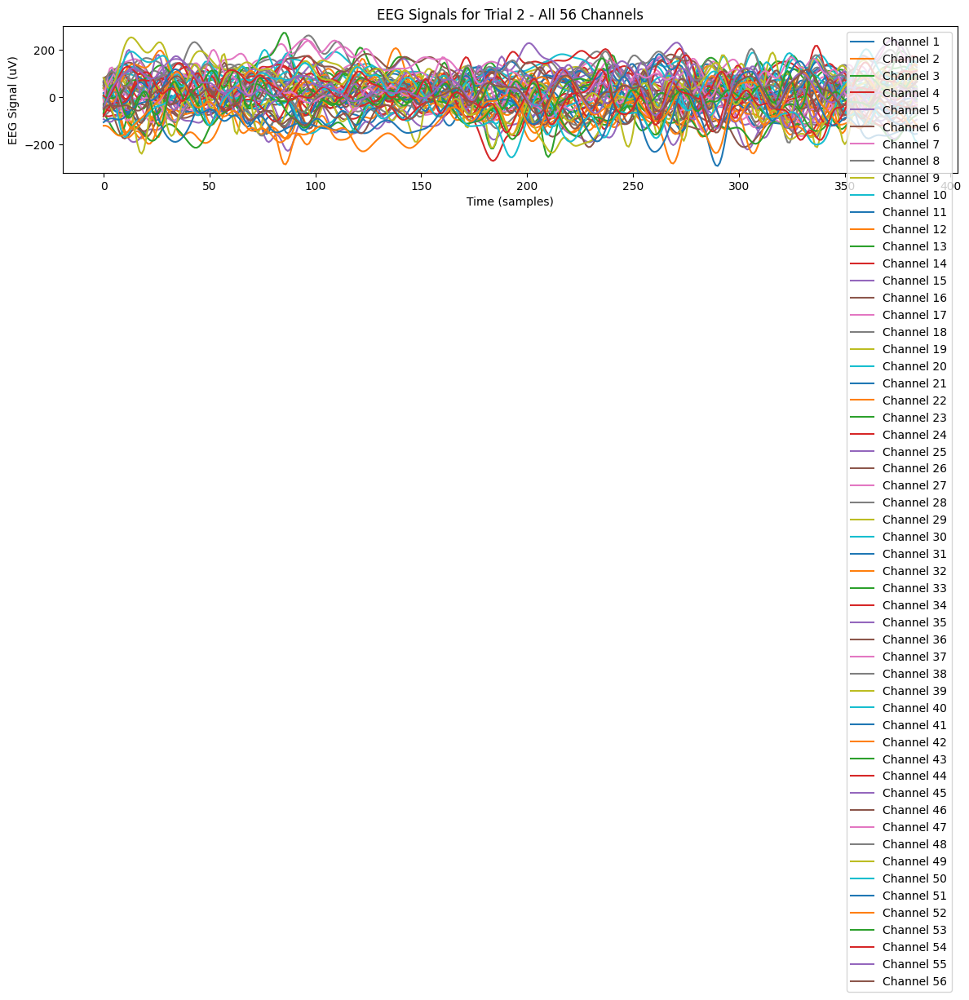

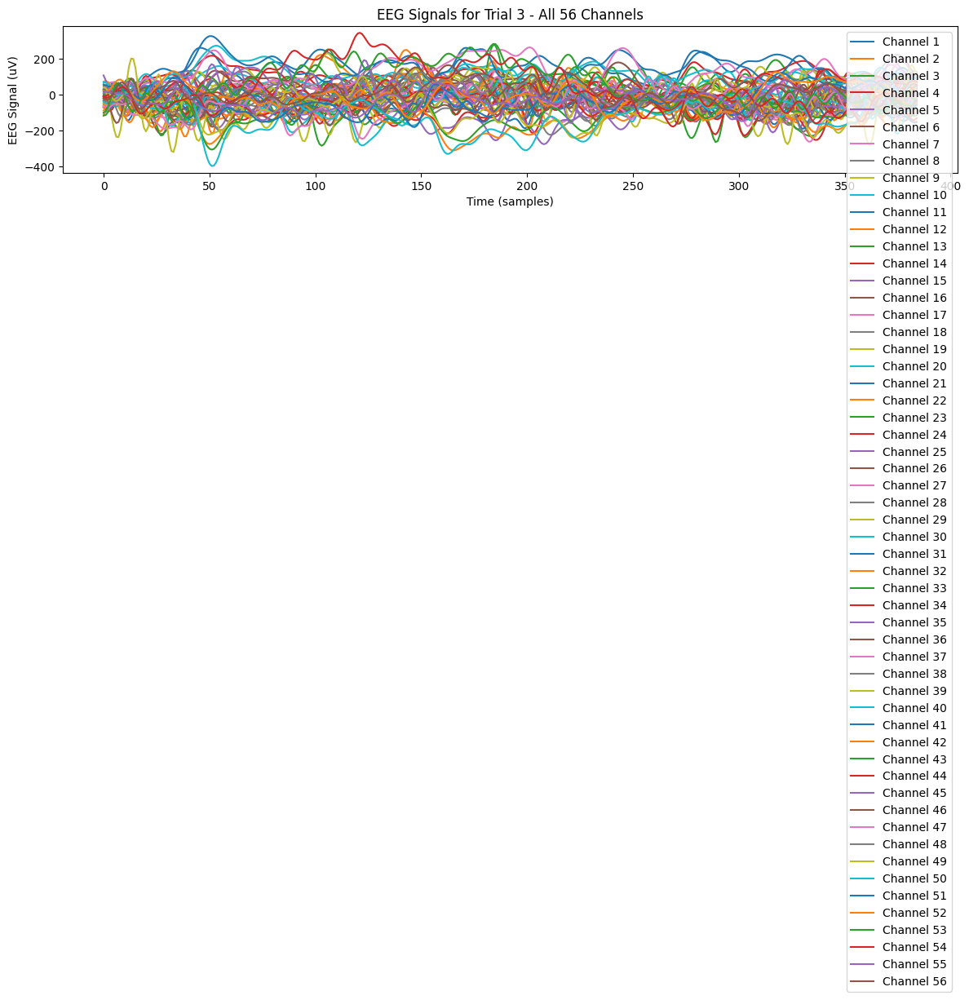

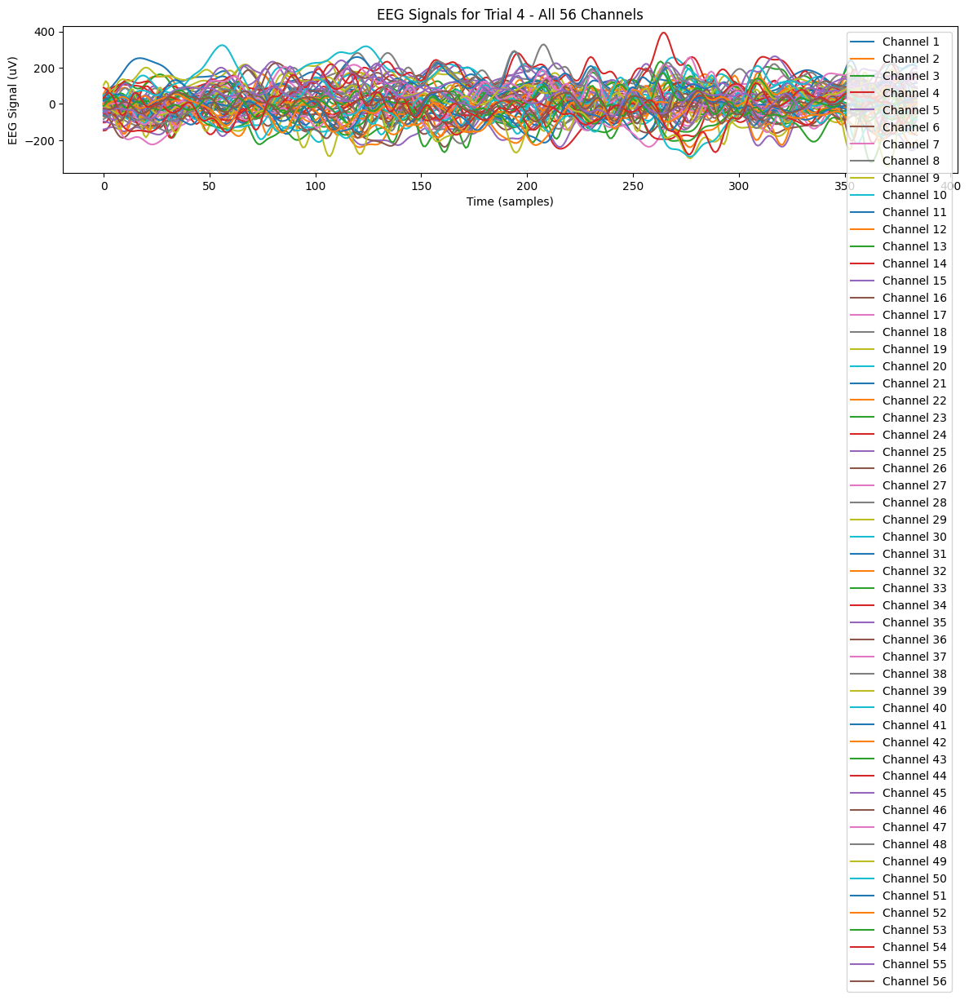

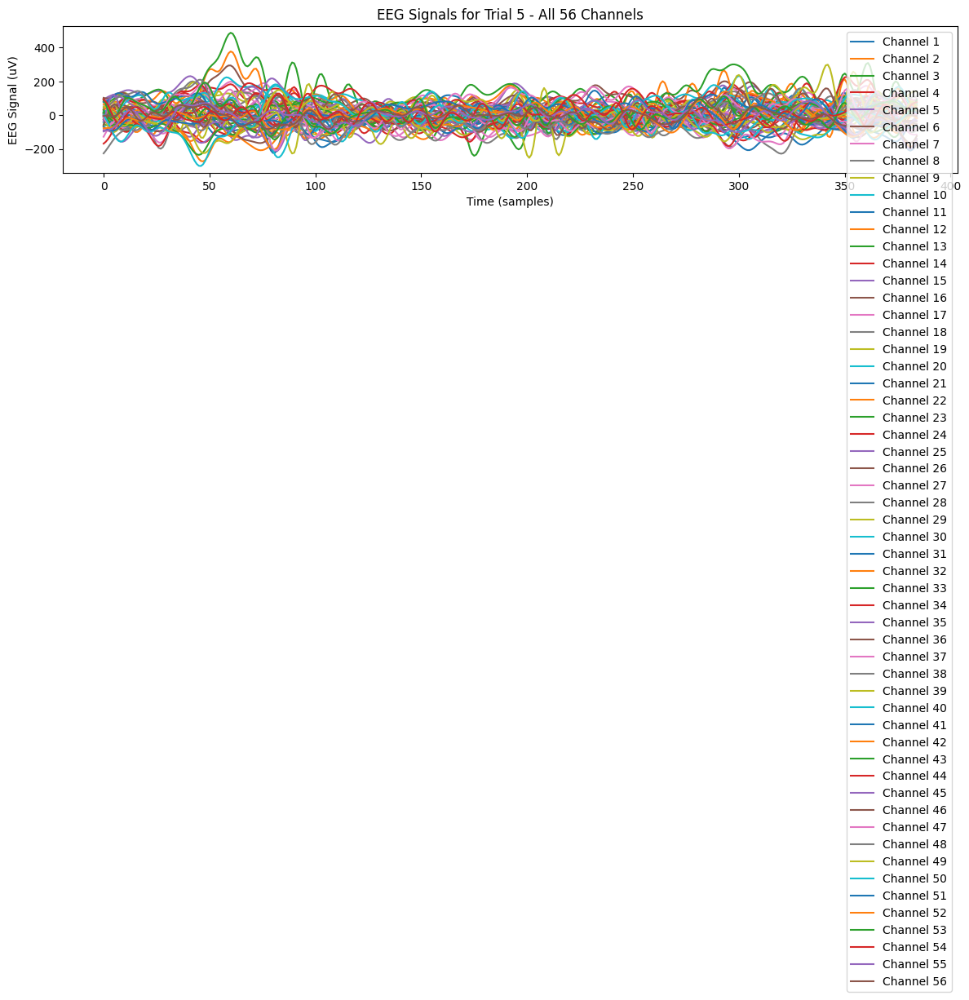

...

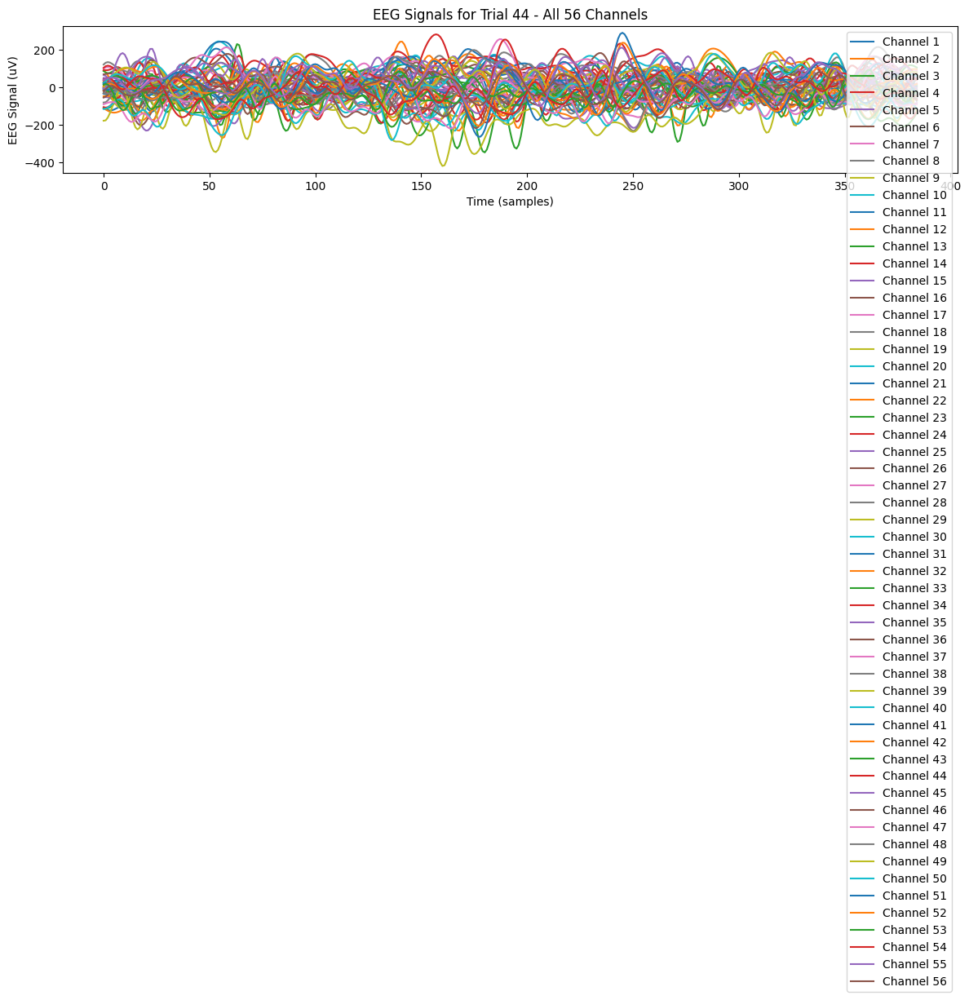

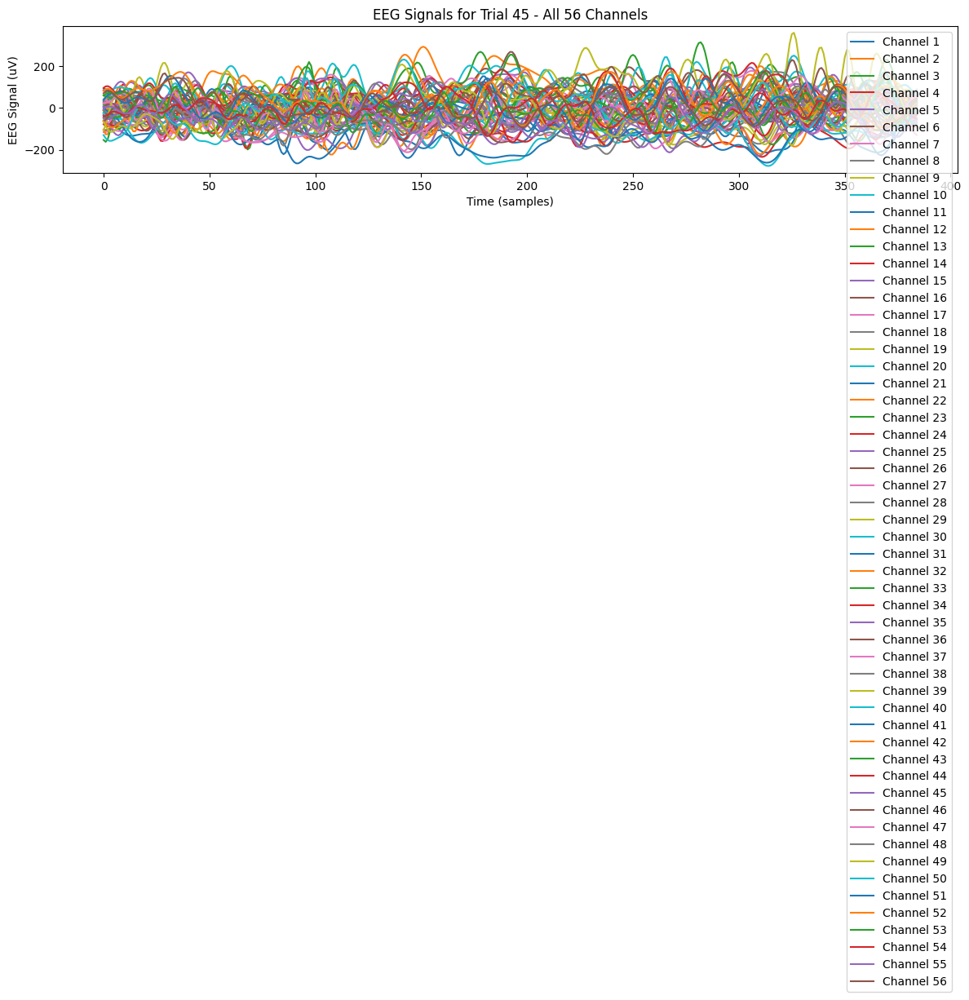

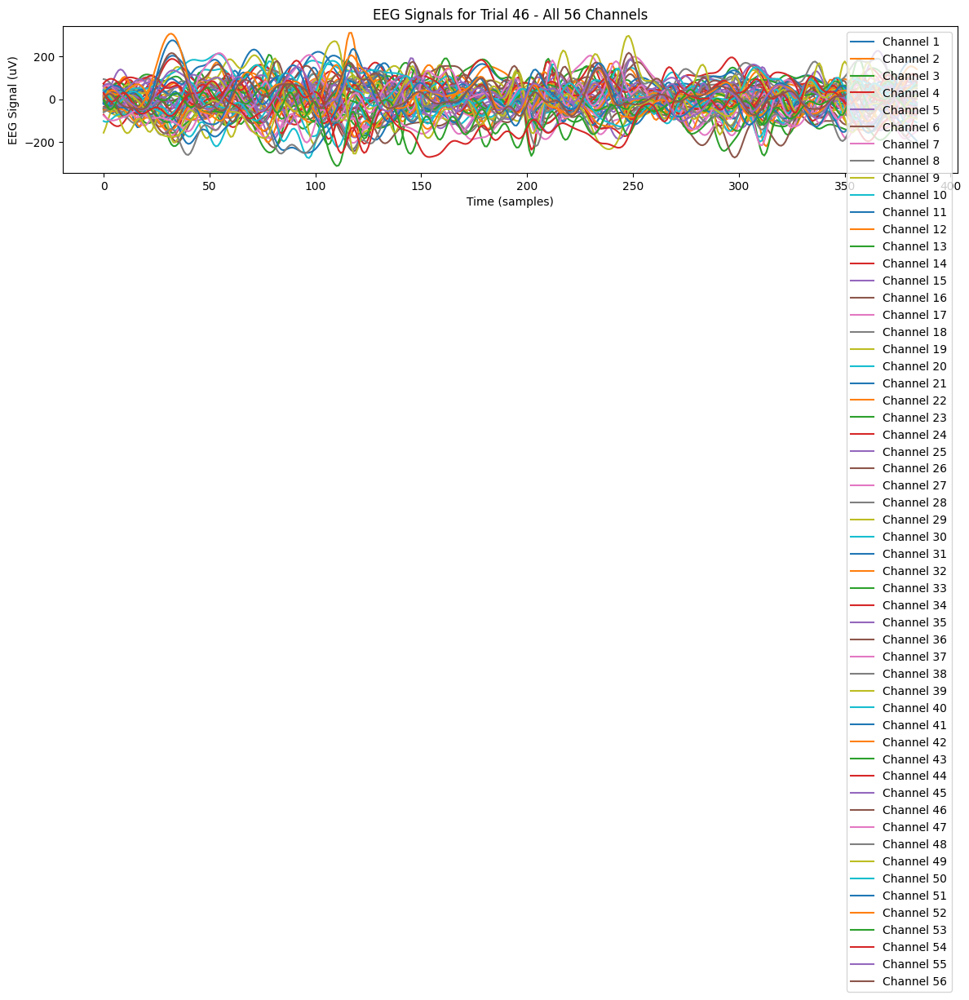

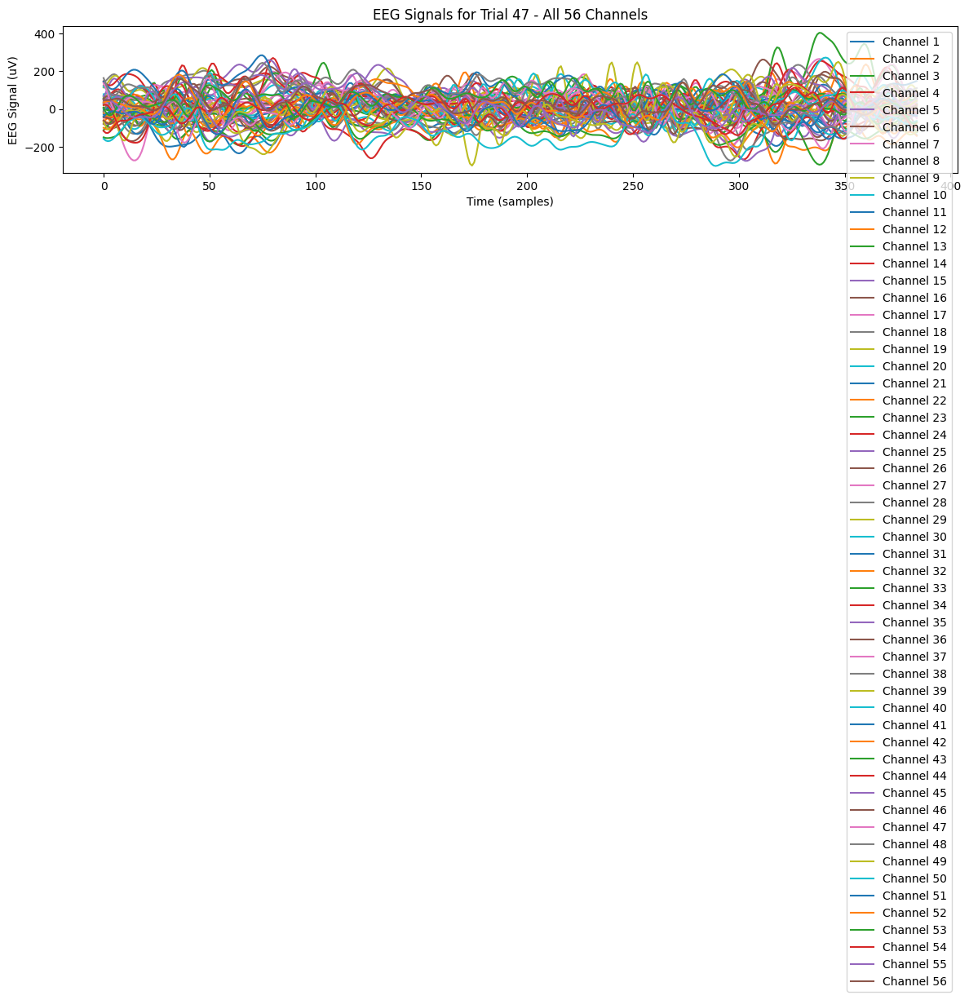

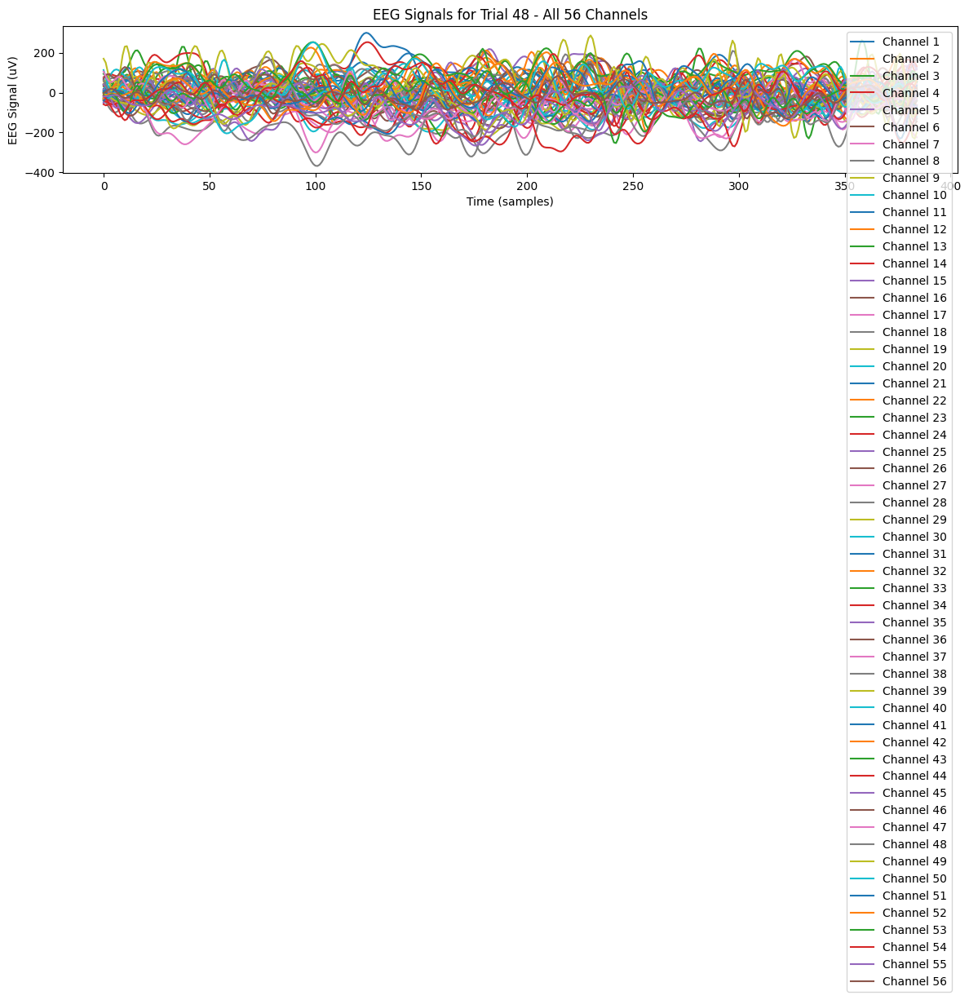

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.io

# Load the EEG data from the train1 file
file_path = '/content/drive/MyDrive/EEG_dataset/splitset/1_train.mat'  # Update with your actual path
eeg_data = scipy.io.loadmat(file_path)

# Extract the EEG data (adjust according to the structure of your .mat file)
eeg_data = eeg_data['train_data']  # Adjust based on your actual key in the .mat file

# Check the shape of the EEG data (should be (n_timepoints, n_channels, n_trials))
print(f"EEG data shape: {eeg_data.shape}")

# Set up the number of channels, trials, and timepoints
n_channels = eeg_data.shape[1]  # Number of EEG channels (56)
n_trials = eeg_data.shape[2]  # Number of trials
n_timepoints = eeg_data.shape[0]  # Number of time points per channel

# Loop through each trial and plot separately
for trial_idx in range(n_trials):
    plt.figure(figsize=(12, 8))

    for channel_idx in range(n_channels):
        # Extract data for the given channel and trial
        channel_data = eeg_data[:, channel_idx, trial_idx]

        # Plot the data for the current channel
        plt.plot(channel_data, label=f"Channel {channel_idx + 1}")

    plt.title(f"EEG Signals for Trial {trial_idx + 1} - All 56 Channels")
    plt.xlabel("Time (samples)")
    plt.ylabel("EEG Signal (uV)")
    plt.legend(loc="upper right")
    plt.tight_layout()
    plt.show()  # Show each trial in a separate plot


EEG data shape: (385, 56, 257)
Processing trial 1 of 257 trials...


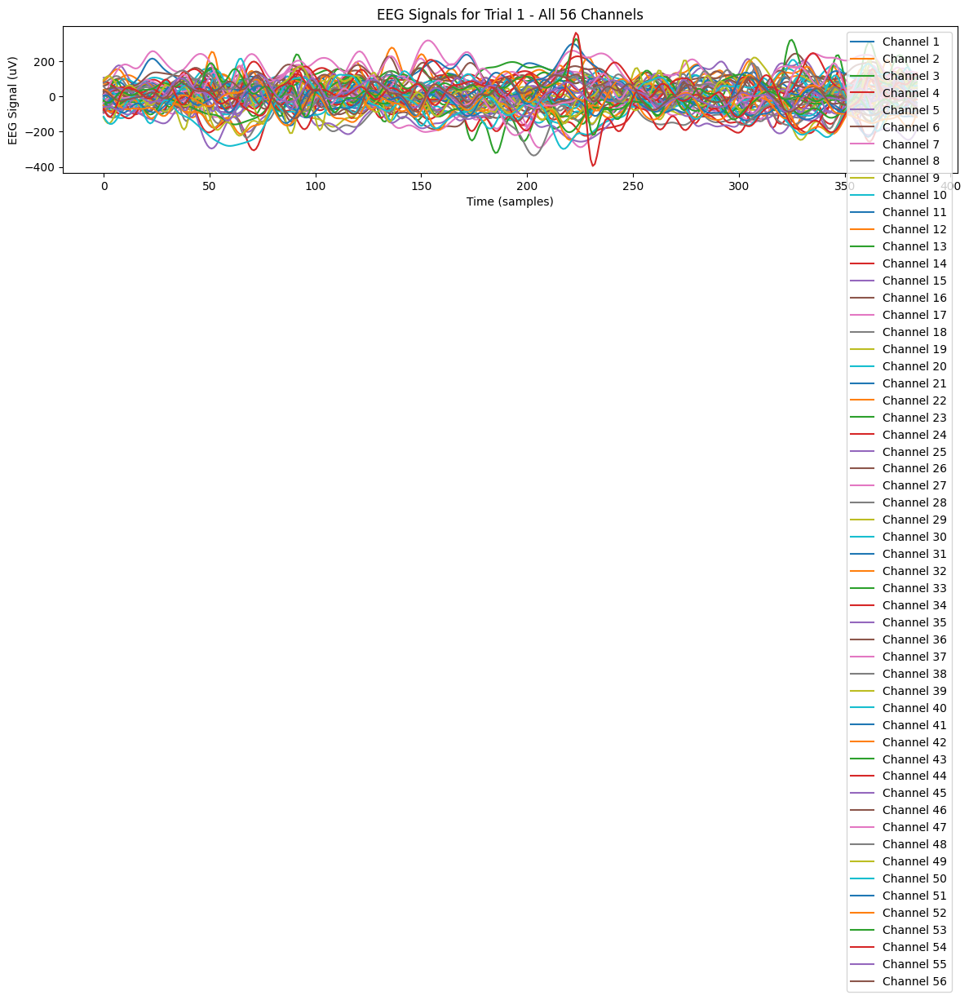

Processing trial 2 of 257 trials...


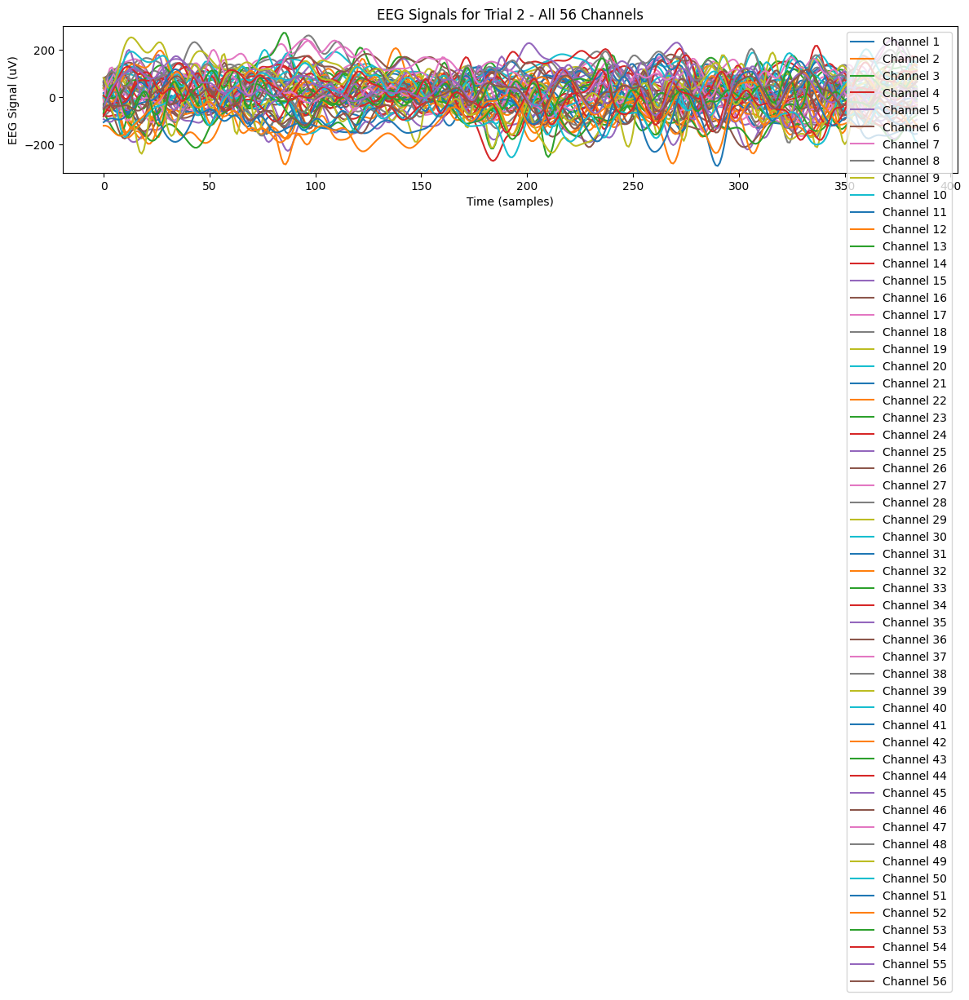

Processing trial 3 of 257 trials...


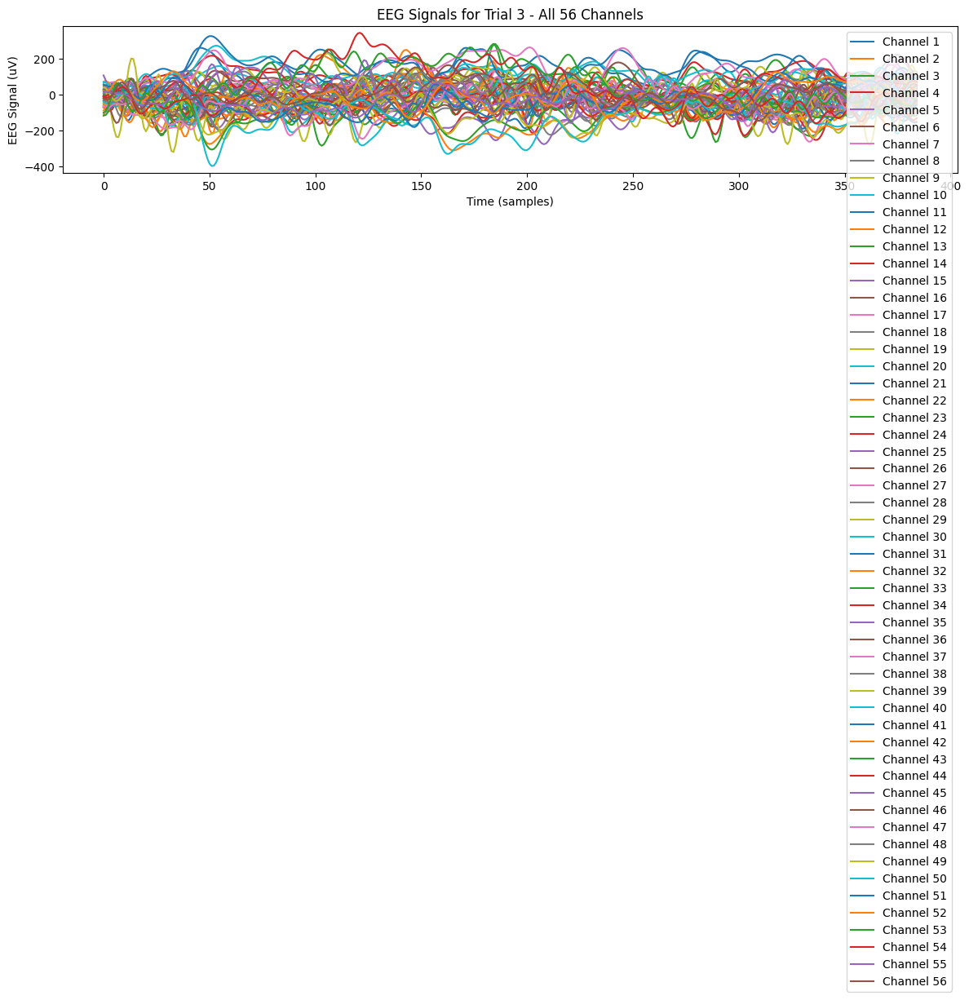

Processing trial 4 of 257 trials...


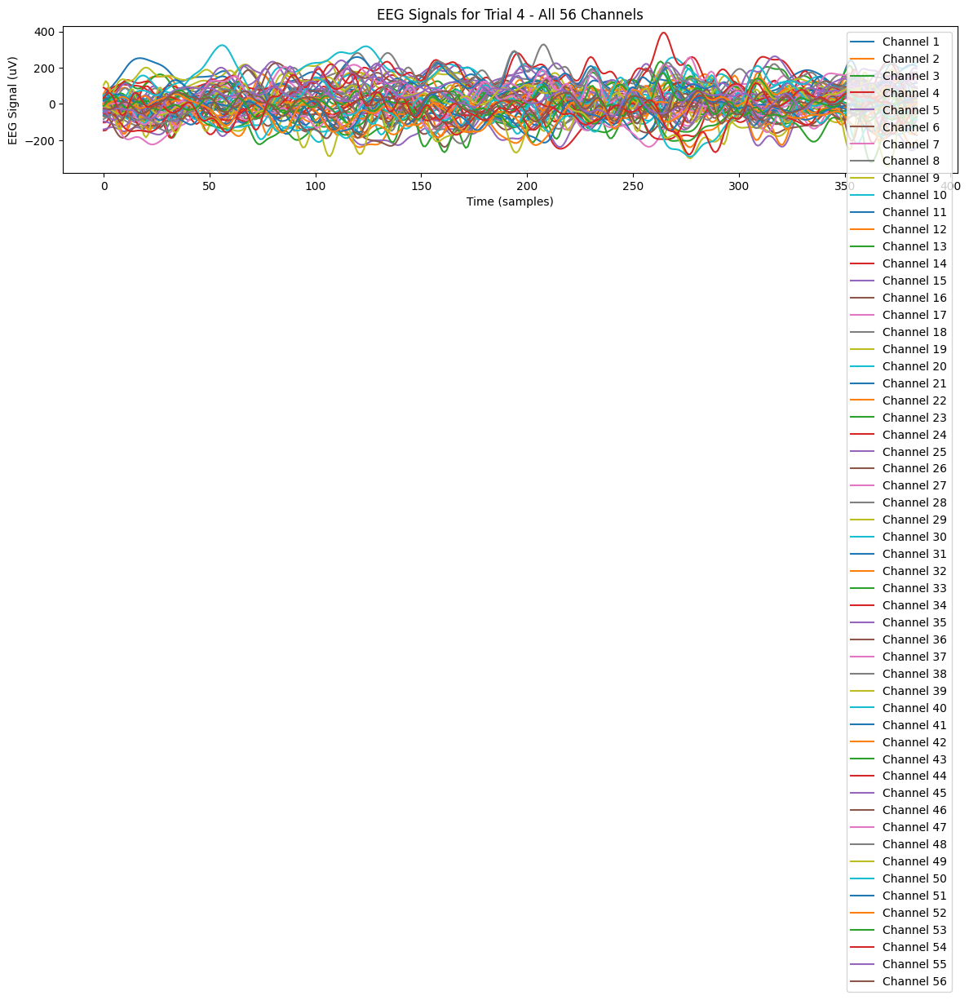

Processing trial 5 of 257 trials...


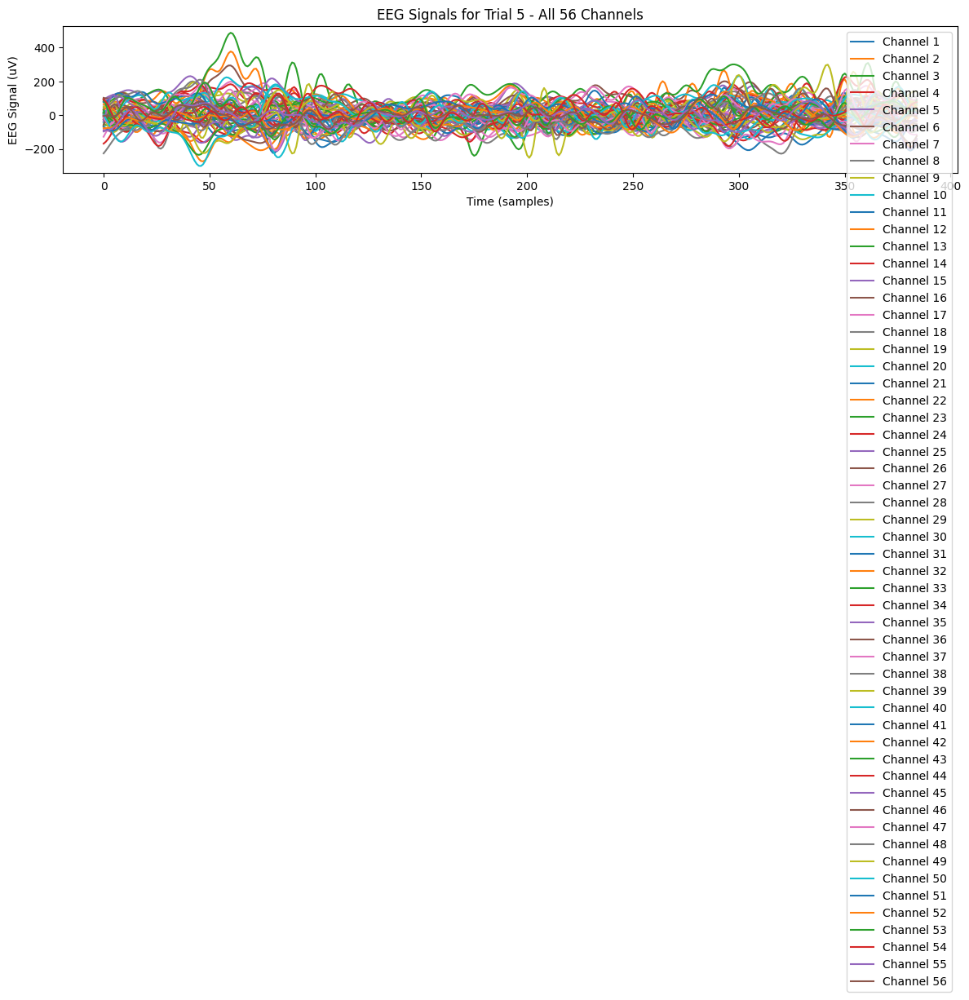

Processing trial 6 of 257 trials...


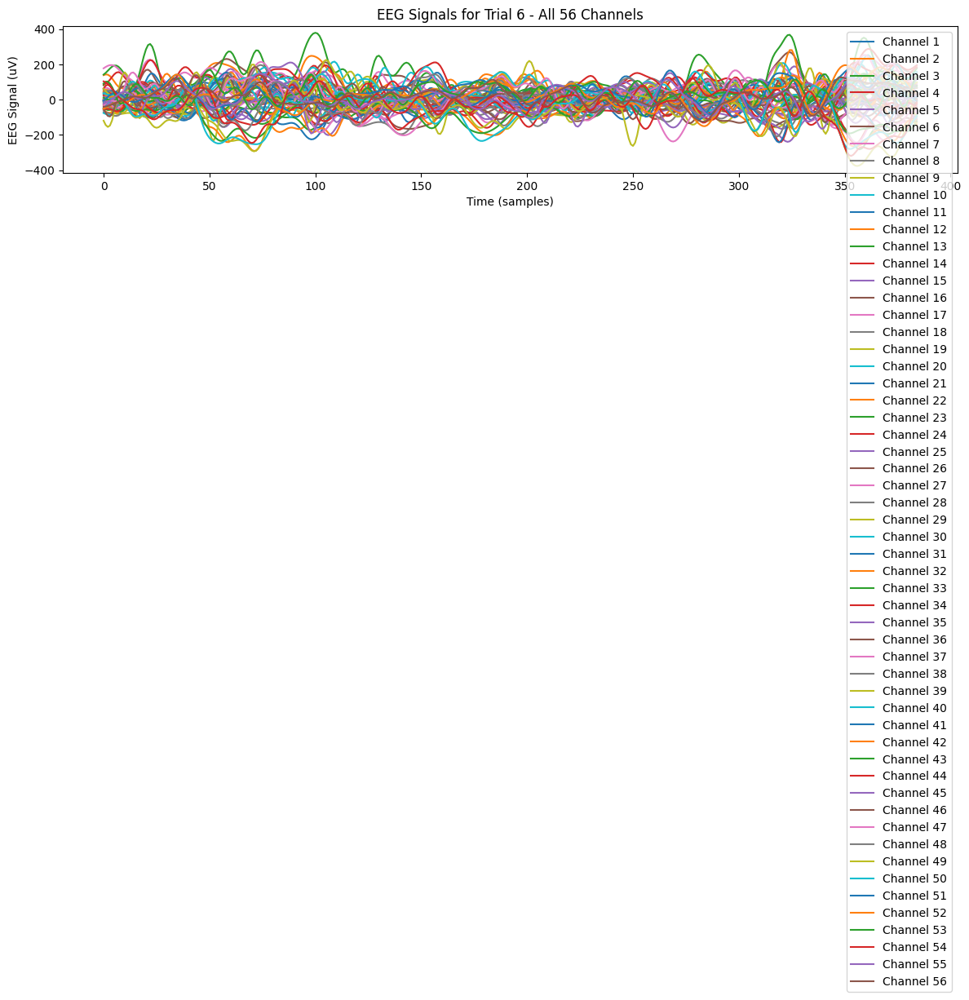

Processing trial 7 of 257 trials...


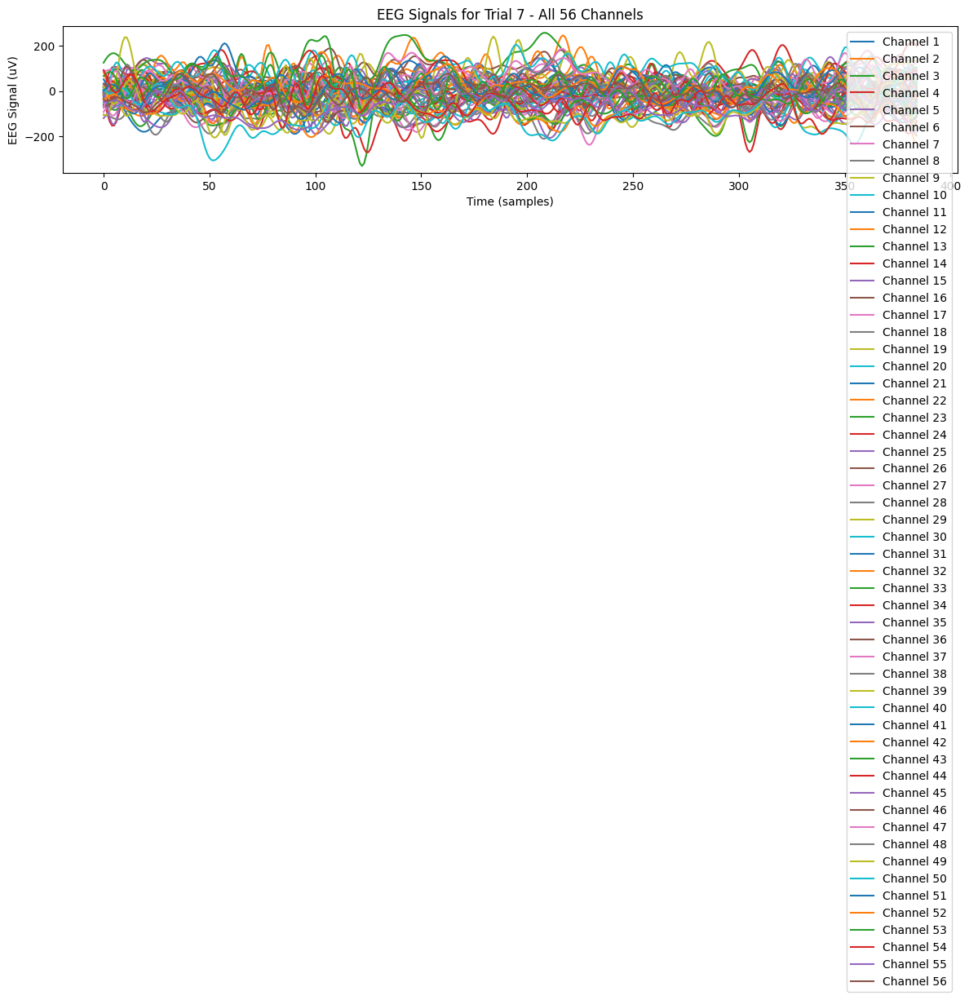

Processing trial 8 of 257 trials...


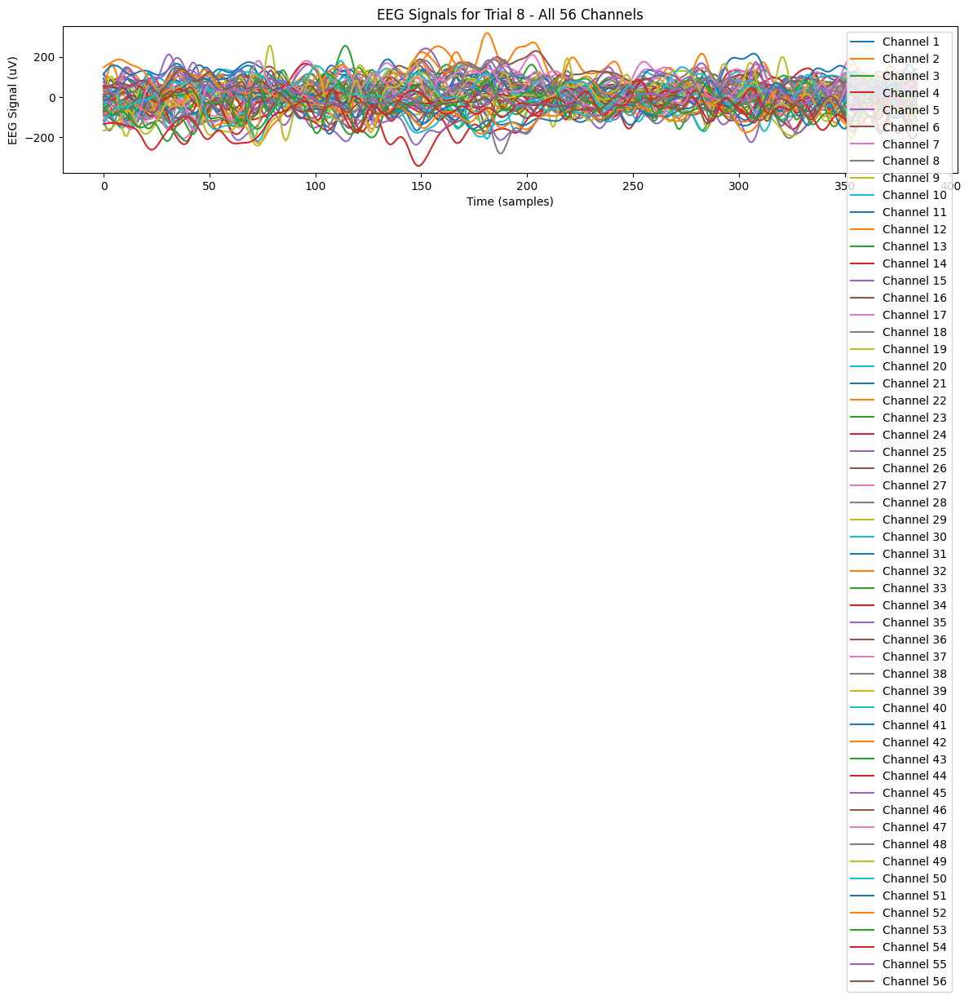

Processing trial 9 of 257 trials...


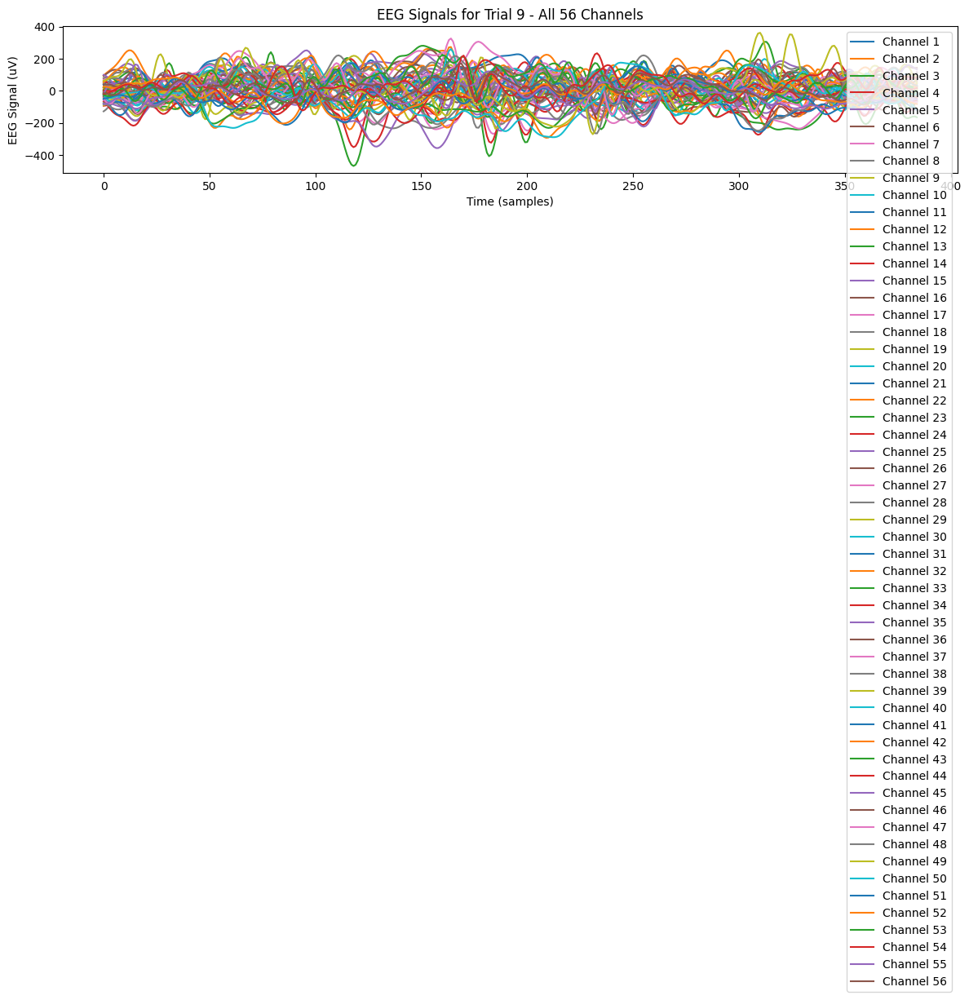

Processing trial 10 of 257 trials...


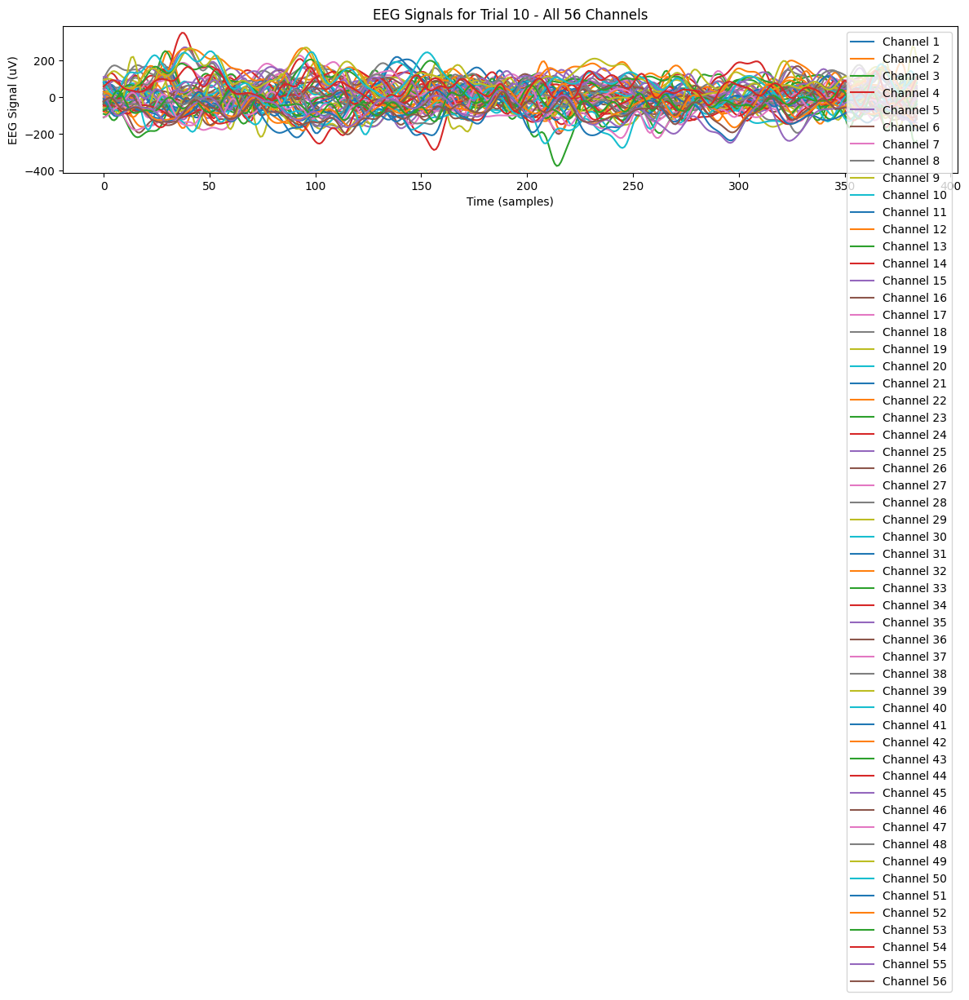

Processing trial 11 of 257 trials...


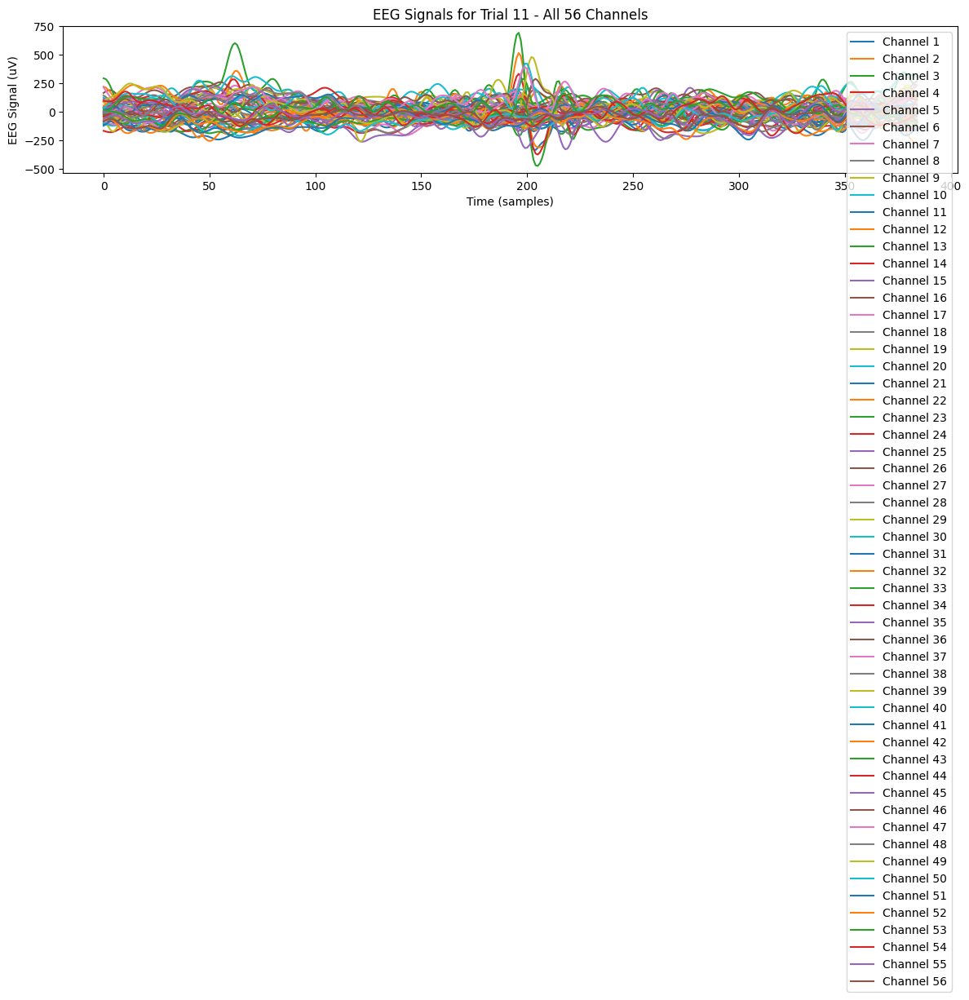

Processing trial 12 of 257 trials...


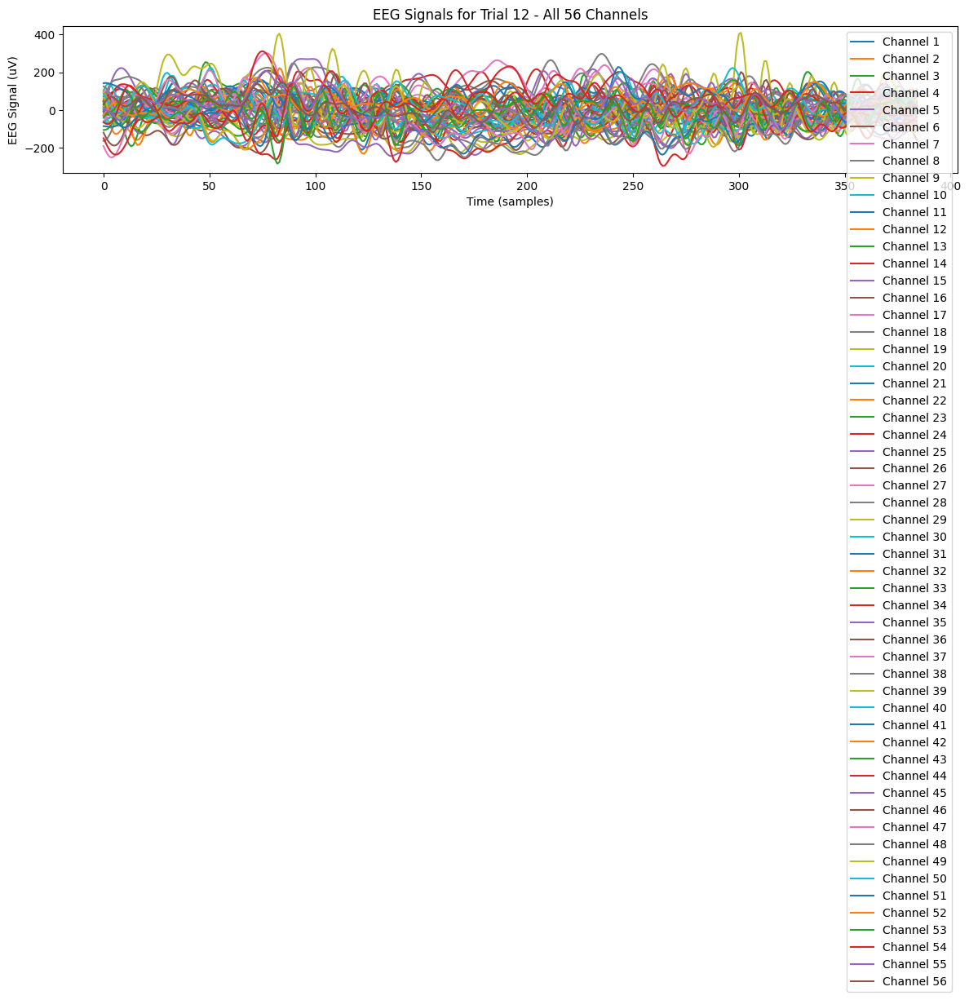

Processing trial 13 of 257 trials...


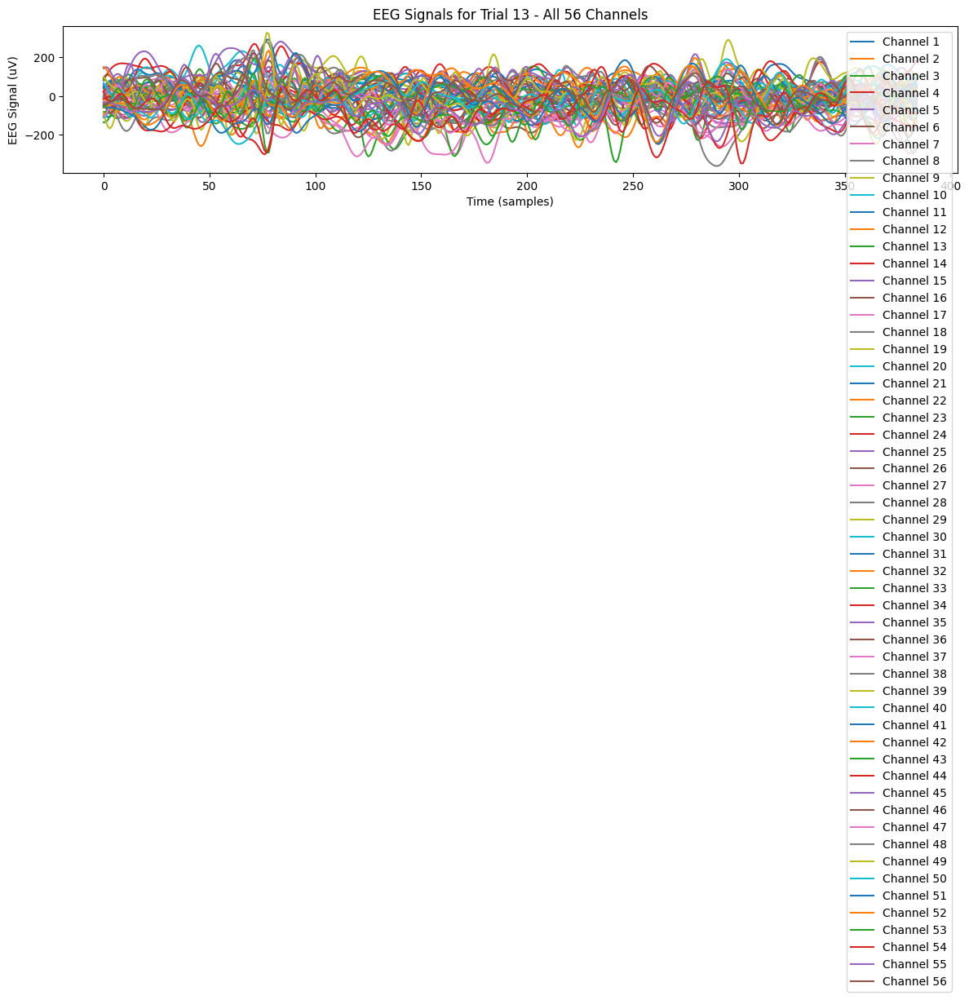

Processing trial 14 of 257 trials...


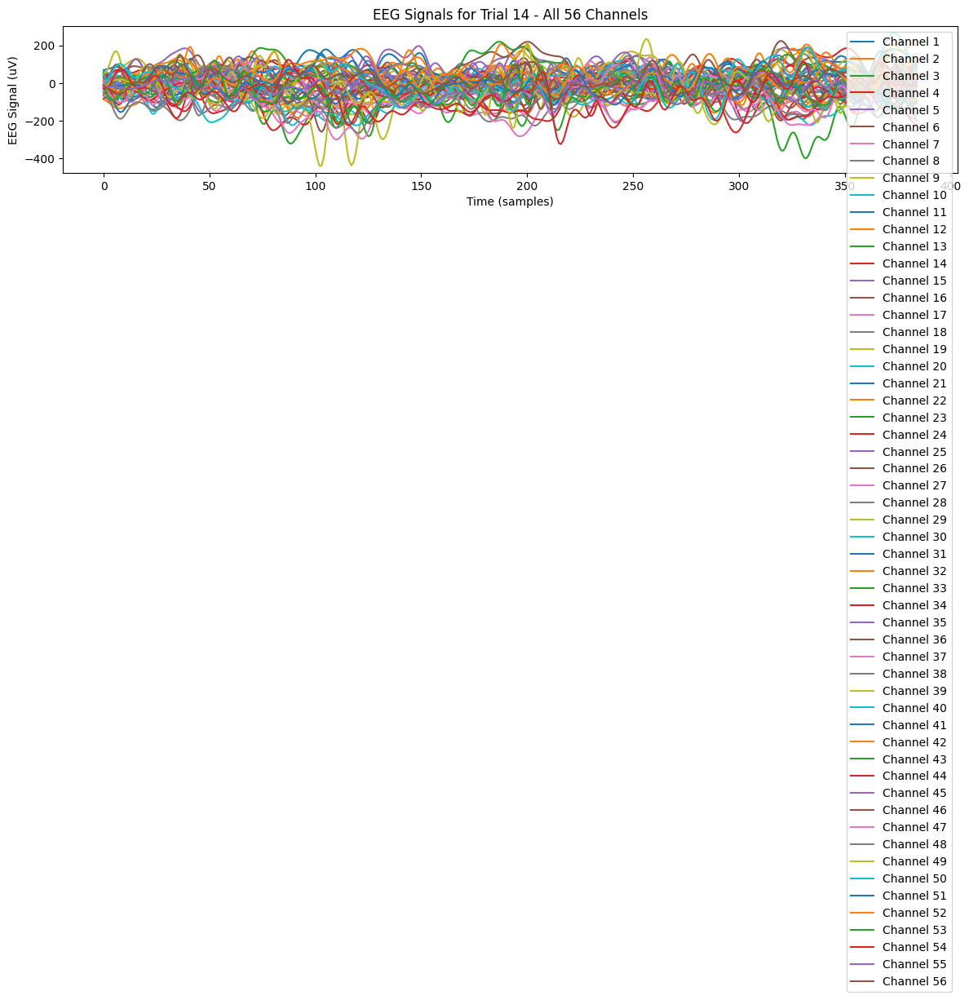

Processing trial 15 of 257 trials...


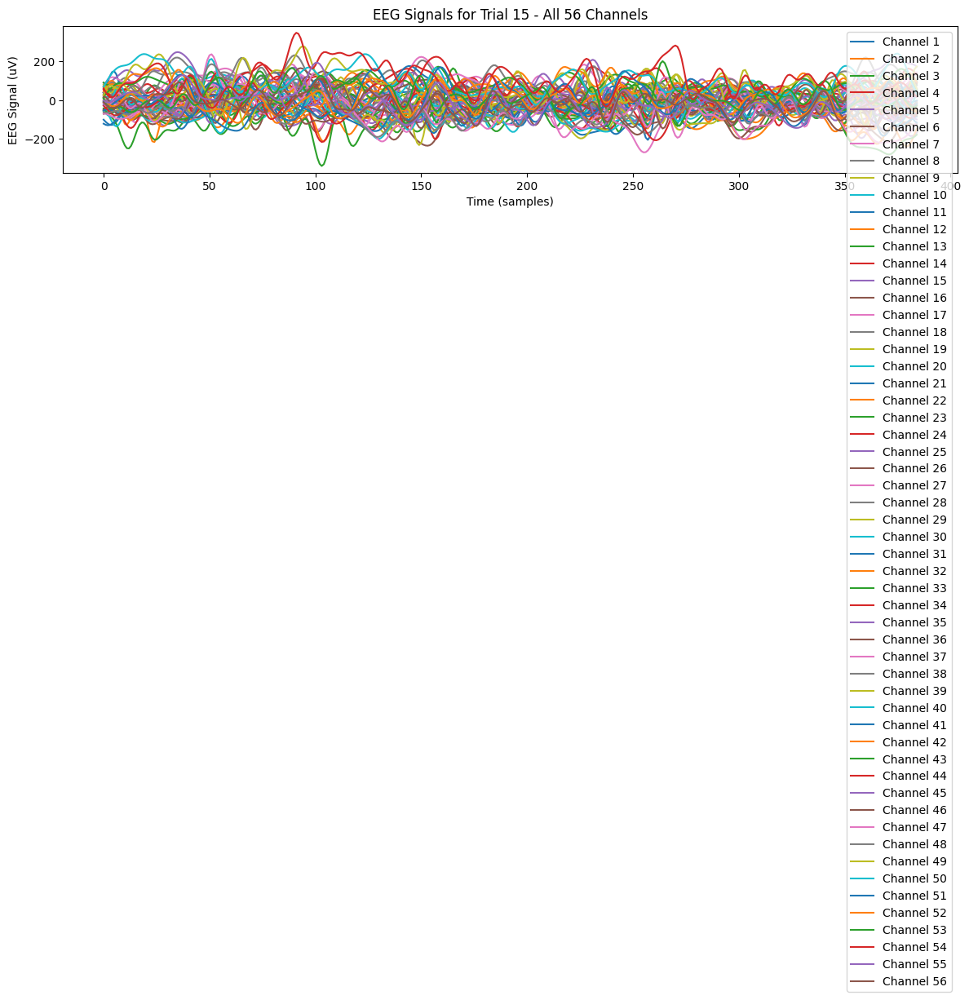

Processing trial 16 of 257 trials...


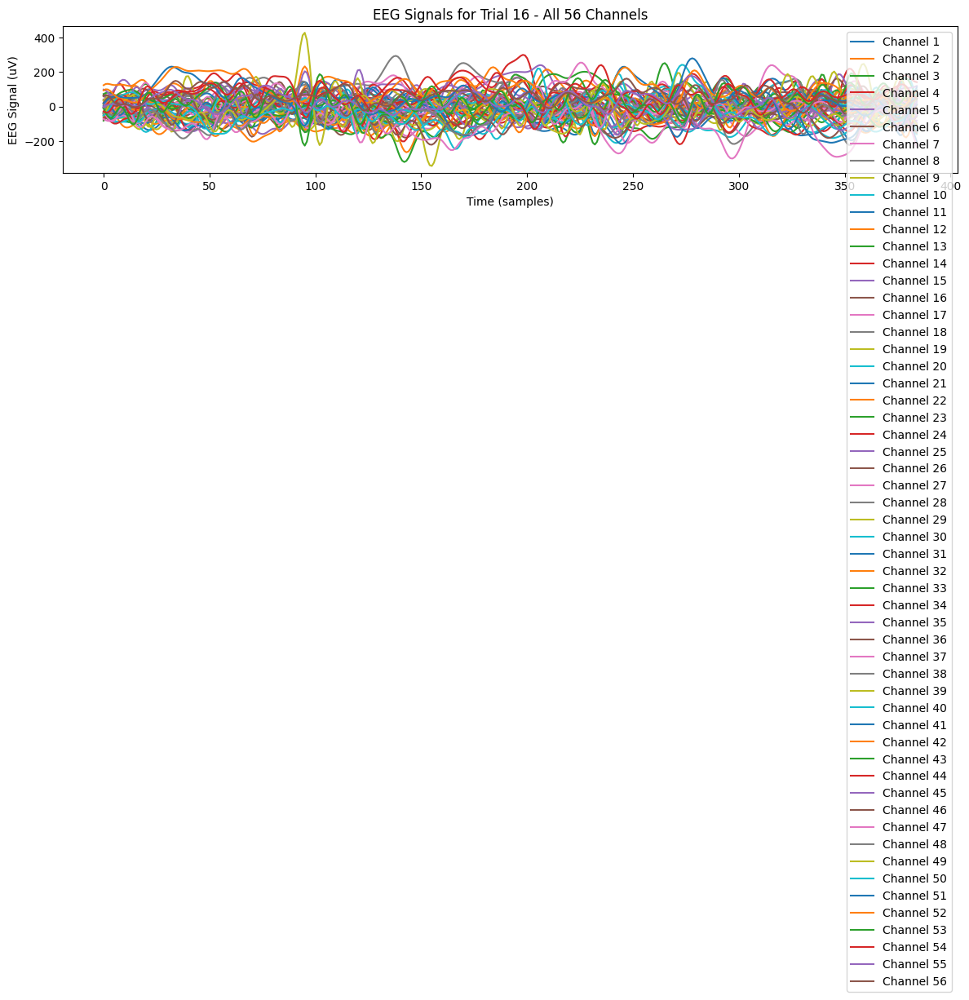

Processing trial 17 of 257 trials...


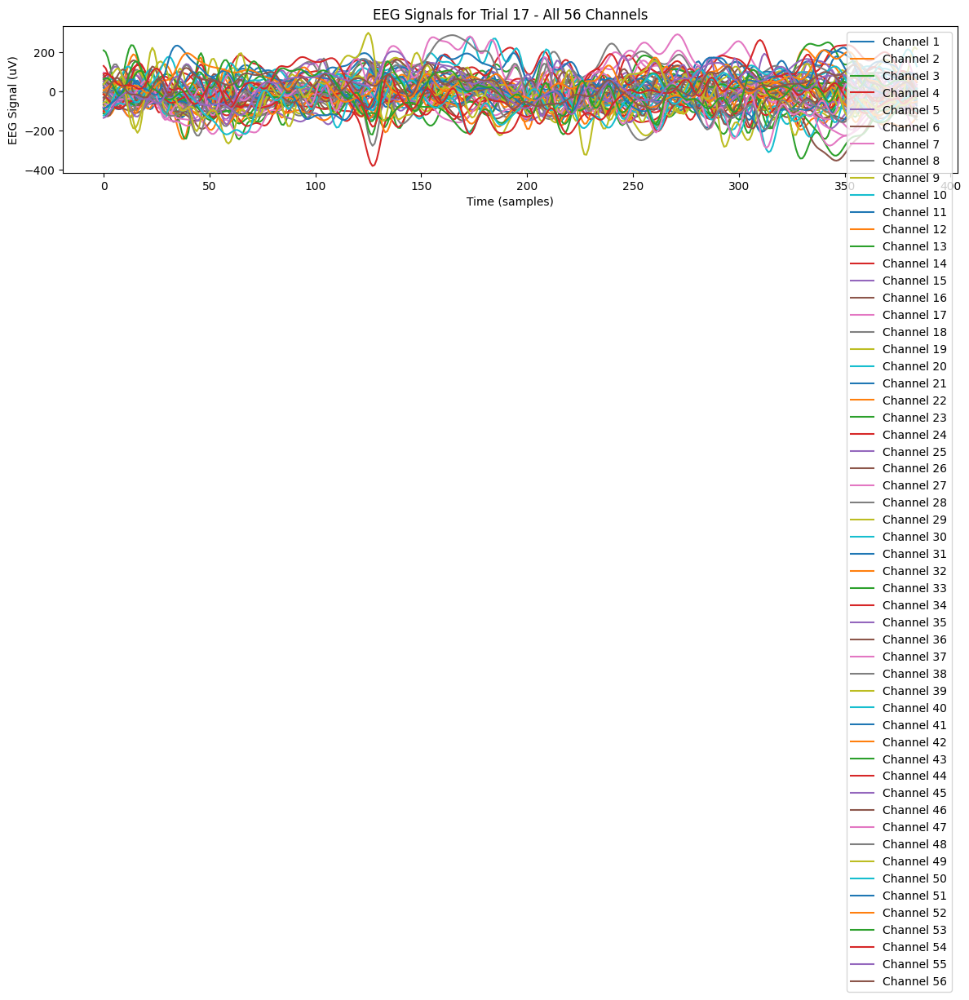

Processing trial 18 of 257 trials...


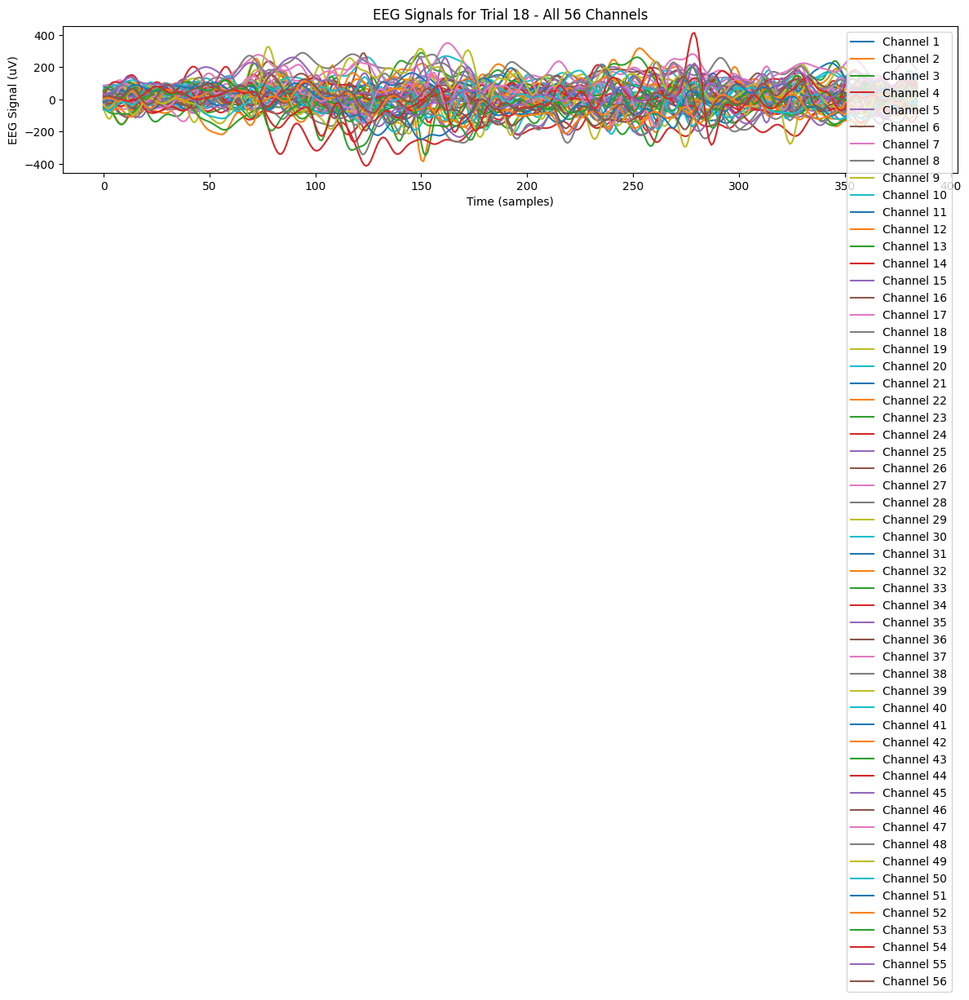

Processing trial 19 of 257 trials...


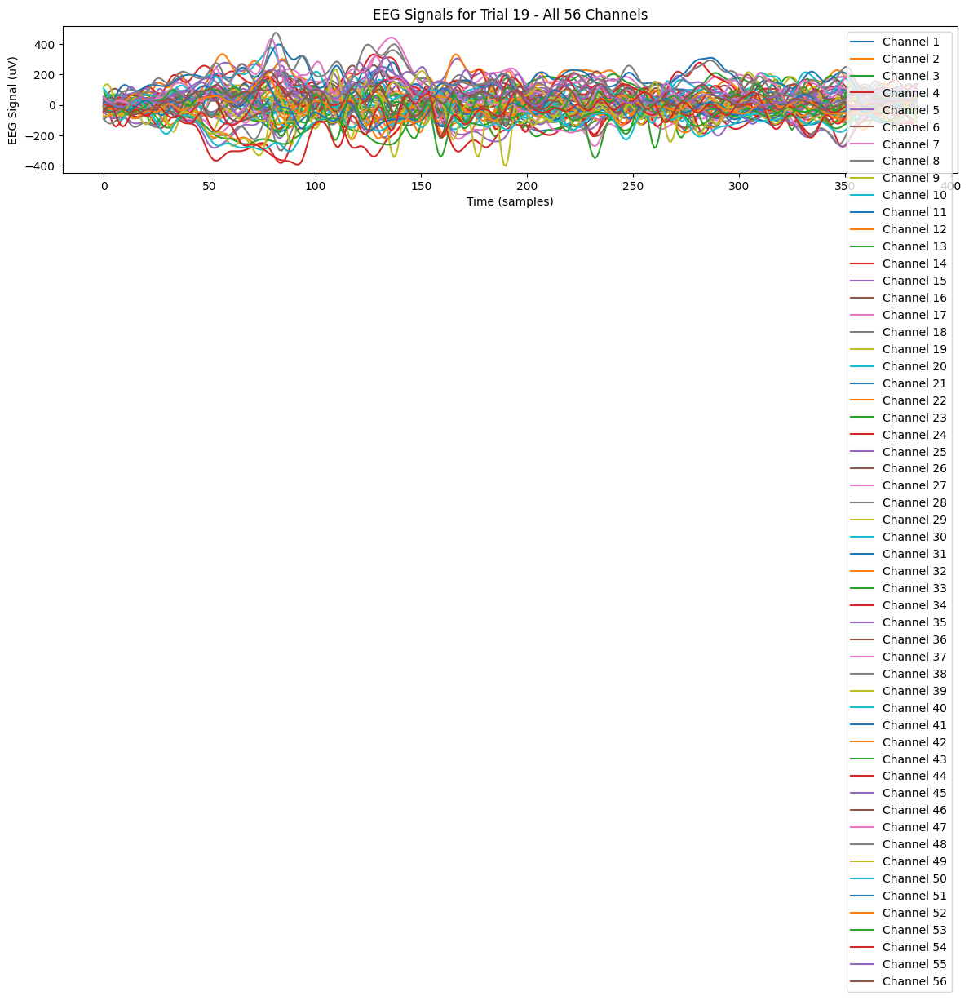

Processing trial 20 of 257 trials...


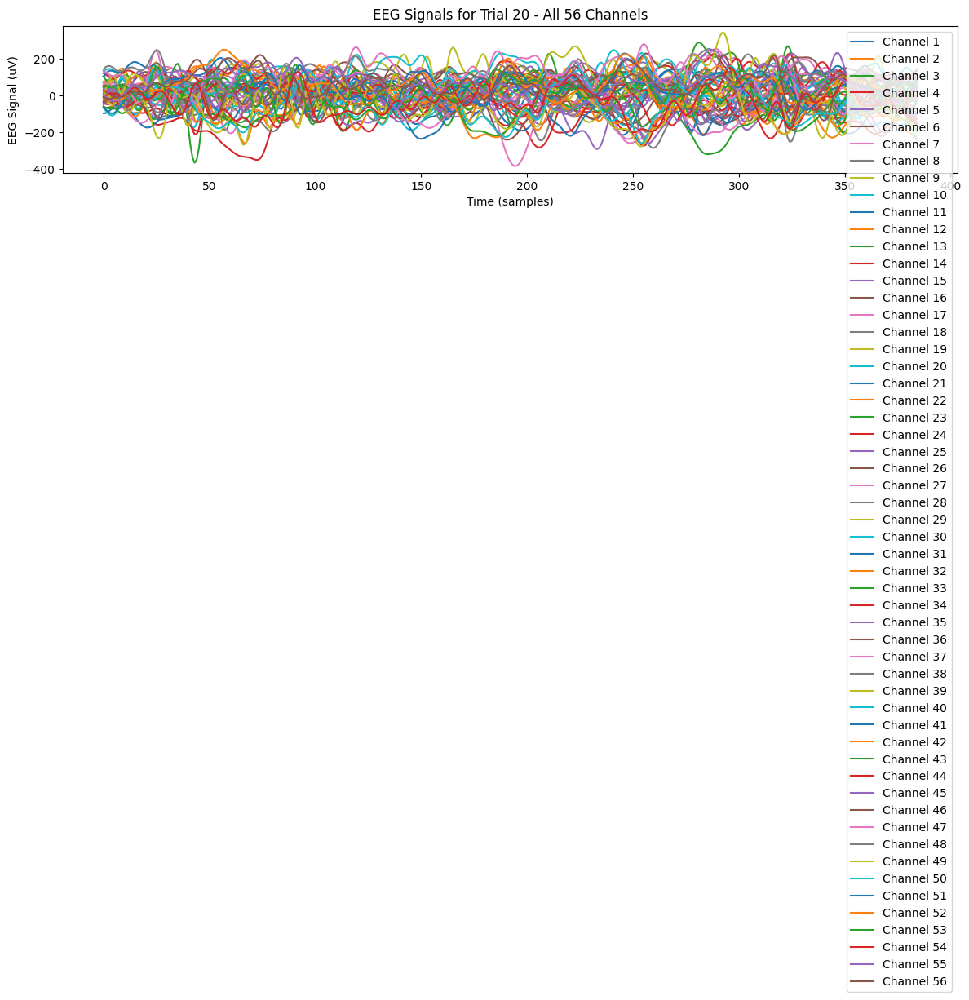

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.io

# Load the EEG data from the train1 file
file_path = '/content/drive/MyDrive/EEG_dataset/splitset/1_train.mat'  # Update with your actual path
eeg_data = scipy.io.loadmat(file_path)

# Extract the EEG data (adjust according to the structure of your .mat file)
eeg_data = eeg_data['train_data']  # Adjust based on your actual key in the .mat file

# Check the shape of the EEG data (should be (n_timepoints, n_channels, n_trials))
print(f"EEG data shape: {eeg_data.shape}")

# Set up the number of channels, trials, and timepoints
n_channels = eeg_data.shape[1]  # Number of EEG channels (56)
n_trials = eeg_data.shape[2]  # Number of trials (257)
n_timepoints = eeg_data.shape[0]  # Number of time points per channel (385)

# Loop through the first 20 trials and plot separately
for trial_idx in range(min(20, n_trials)):  # Loop through the first 20 trials (or fewer if there are less than 20 trials)
    print(f"Processing trial {trial_idx + 1} of {n_trials} trials...")

    plt.figure(figsize=(12, 8))

    for channel_idx in range(n_channels):
        # Extract data for the given channel and trial
        channel_data = eeg_data[:, channel_idx, trial_idx]

        # Plot the data for the current channel
        plt.plot(channel_data, label=f"Channel {channel_idx + 1}")

    plt.title(f"EEG Signals for Trial {trial_idx + 1} - All 56 Channels")
    plt.xlabel("Time (samples)")
    plt.ylabel("EEG Signal (uV)")
    plt.legend(loc="upper right")
    plt.tight_layout()
    plt.show()  # Show each trial in a separate plot


In [ ]:
import os
import numpy as np
import scipy.io

# Directory containing the participant files
directory_path = '/content/drive/MyDrive/EEG_dataset/splitset'

# List all files in the directory
files_in_directory = os.listdir(directory_path)

# Filter out the files that contain 'train' in their name
train_files = [file for file in files_in_directory if 'train' in file]

# Print the count of 'train' files
print(f"Number of 'train' files: {len(train_files)}")

# Loop through each train file in the directory
for file_name in train_files:
    file_path = os.path.join(directory_path, file_name)

    # Load the EEG data from the .mat file
    print(f"Loading file: {file_path}")
    eeg_data = scipy.io.loadmat(file_path)

    # Extract the EEG data (adjust according to the structure of your .mat file)
    eeg_data = eeg_data['train_data']  # Adjust this based on the actual key in the .mat file

    # Check the shape of the EEG data (should be (n_timepoints, n_channels, n_trials))
    print(f"EEG data shape for {file_name}: {eeg_data.shape}")

    # Set up the number of channels, trials, and timepoints
    n_channels = eeg_data.shape[1]  # Number of EEG channels (56)
    n_trials = eeg_data.shape[2]  # Number of trials
    n_timepoints = eeg_data.shape[0]  # Number of time points per channel

    # Loop through each trial and print a statement for each
    for trial_idx in range(n_trials):
        print(f"Processing trial {trial_idx + 1} of {n_trials} trials in file: {file_name}")


Streaming output truncated to the last 5000 lines.
Processing trial 255 of 262 trials in file: 6_train.mat
Processing trial 256 of 262 trials in file: 6_train.mat
Processing trial 257 of 262 trials in file: 6_train.mat
Processing trial 258 of 262 trials in file: 6_train.mat
Processing trial 259 of 262 trials in file: 6_train.mat
Processing trial 260 of 262 trials in file: 6_train.mat
Processing trial 261 of 262 trials in file: 6_train.mat
Processing trial 262 of 262 trials in file: 6_train.mat
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/12_train.mat
EEG data shape for 12_train.mat: (385, 56, 255)
Processing trial 1 of 255 trials in file: 12_train.mat
Processing trial 2 of 255 trials in file: 12_train.mat
Processing trial 3 of 255 trials in file: 12_train.mat
Processing trial 4 of 255 trials in file: 12_train.mat
Processing trial 5 of 255 trials in file: 12_train.mat
Processing trial 6 of 255 trials in file: 12_train.mat
Processing trial 7 of 255 trials in file: 12_train.m

In [ ]:
import numpy as np
import scipy.io
from scipy.stats import zscore
import os

# Function to extract P300 features (latency and amplitude)
def extract_p300_features(eeg_data, channel_idx=25, fs=256, p300_window=(300, 600)):
    """
    Extract P300 features (latency and amplitude) from a single channel for each trial.

    eeg_data: 2D numpy array (n_timepoints, n_trials)
    channel_idx: Index of the channel to extract the signal from (1-based index, e.g., 25 for channel 25)
    fs: Sampling rate (Hz)
    p300_window: Time window for extracting P300 peak (ms)

    Returns: Latencies and Amplitudes for each trial
    """
    # Convert from 1-based index to 0-based index
    channel_idx = channel_idx - 1  # 1-based to 0-based indexing

    # Convert P300 window from ms to sample indices
    start_sample = int(p300_window[0] / 1000 * fs)  # 300 ms -> samples
    end_sample = int(p300_window[1] / 1000 * fs)  # 600 ms -> samples

    # Extract the signal for the chosen channel
    signal = eeg_data[:, channel_idx]

    latencies = []
    amplitudes = []

    # Loop through each trial
    n_trials = signal.shape[1]  # Number of trials
    for trial_idx in range(n_trials):
        trial_signal = signal[:, trial_idx]

        # Extract the P300 window from the trial signal
        p300_signal = trial_signal[start_sample:end_sample]

        # Find the latency (time of the maximum peak in the P300 window)
        p300_peak_idx = np.argmax(p300_signal)
        latency = (p300_peak_idx + start_sample) / fs  # Convert sample index to time (seconds)

        # Amplitude (maximum value in the P300 window)
        amplitude = np.max(p300_signal)

        latencies.append(latency)
        amplitudes.append(amplitude)

    # Return latencies and amplitudes
    return np.array(latencies), np.array(amplitudes)

# Directory containing the participant files
directory_path = '/content/drive/MyDrive/EEG_dataset/splitset'

# List all files in the directory
files_in_directory = os.listdir(directory_path)

# Filter out the files that contain 'train' in their name
train_files = [file for file in files_in_directory if 'train' in file]

# Initialize lists to store latencies and amplitudes for all trials
all_latencies = []
all_amplitudes = []

# Loop through each train file in the directory
for file_name in train_files:
    file_path = os.path.join(directory_path, file_name)

    # Load the EEG data from the .mat file
    print(f"Loading file: {file_path}")
    eeg_data = scipy.io.loadmat(file_path)

    # Extract the EEG data (adjust according to the structure of your .mat file)
    eeg_data = eeg_data['train_data']  # Adjust this based on the actual key in the .mat file

    # Check the shape of the EEG data (should be (n_timepoints, n_channels, n_trials))
    print(f"EEG data shape for {file_name}: {eeg_data.shape}")

    # Set up the number of channels, trials, and timepoints
    n_channels = eeg_data.shape[1]  # Number of EEG channels (56)
    n_trials = eeg_data.shape[2]  # Number of trials
    n_timepoints = eeg_data.shape[0]  # Number of time points per channel

    # Extract P300 features (latency and amplitude) from channel 25 for each trial
    latencies, amplitudes = extract_p300_features(eeg_data, channel_idx=25, fs=256)

    # Append the latencies and amplitudes for all trials
    all_latencies.append(latencies)
    all_amplitudes.append(amplitudes)

# Combine all latencies and amplitudes from all participants/trials
all_latencies = np.concatenate(all_latencies)
all_amplitudes = np.concatenate(all_amplitudes)

# Normalize the features using Z-score
latencies_zscore = zscore(all_latencies)
amplitudes_zscore = zscore(all_amplitudes)

# Prepare the feature matrix (each row represents a trial)
feature_matrix = np.column_stack([latencies_zscore, amplitudes_zscore])

# Print the feature matrix for verification
print(f"Feature matrix shape: {feature_matrix.shape}")
print("Feature matrix (first few rows):")
print(feature_matrix[:5])


Loading file: /content/drive/MyDrive/EEG_dataset/splitset/14_train.mat
EEG data shape for 14_train.mat: (385, 56, 238)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/18_train.mat
EEG data shape for 18_train.mat: (385, 56, 195)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/16_train.mat
EEG data shape for 16_train.mat: (385, 56, 125)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/10_train.mat
EEG data shape for 10_train.mat: (385, 56, 265)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/17_train.mat
EEG data shape for 17_train.mat: (385, 56, 239)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/30_train.mat
EEG data shape for 30_train.mat: (385, 56, 290)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/33_train.mat
EEG data shape for 33_train.mat: (385, 56, 172)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/1_train.mat
EEG data shape for 1_train.mat: (385, 56, 257)
Loading file: /content/drive/MyDrive/EEG_dataset/s

Loading file: /content/drive/MyDrive/EEG_dataset/splitset/14_train.mat
EEG data shape for 14_train.mat: (385, 56, 238)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/18_train.mat
EEG data shape for 18_train.mat: (385, 56, 195)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/16_train.mat
EEG data shape for 16_train.mat: (385, 56, 125)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/10_train.mat
EEG data shape for 10_train.mat: (385, 56, 265)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/17_train.mat
EEG data shape for 17_train.mat: (385, 56, 239)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/30_train.mat
EEG data shape for 30_train.mat: (385, 56, 290)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/33_train.mat
EEG data shape for 33_train.mat: (385, 56, 172)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/1_train.mat
EEG data shape for 1_train.mat: (385, 56, 257)
Loading file: /content/drive/MyDrive/EEG_dataset/s

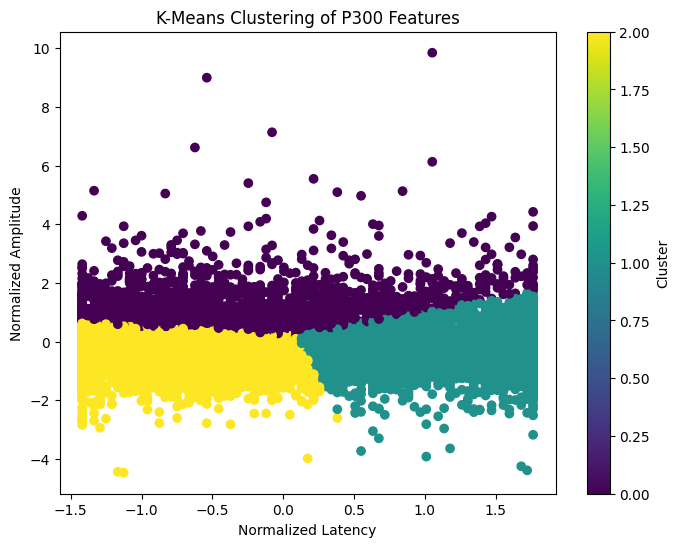

In [ ]:
import numpy as np
import scipy.io
from scipy.stats import zscore
import os
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Function to extract P300 features (latency and amplitude)
def extract_p300_features(eeg_data, channel_idx=25, fs=256, p300_window=(300, 600)):
    """
    Extract P300 features (latency and amplitude) from a single channel for each trial.

    eeg_data: 2D numpy array (n_timepoints, n_trials)
    channel_idx: Index of the channel to extract the signal from (1-based index, e.g., 25 for channel 25)
    fs: Sampling rate (Hz)
    p300_window: Time window for extracting P300 peak (ms)

    Returns: Latencies and Amplitudes for each trial
    """
    # Convert from 1-based index to 0-based index
    channel_idx = channel_idx - 1  # 1-based to 0-based indexing

    # Convert P300 window from ms to sample indices
    start_sample = int(p300_window[0] / 1000 * fs)  # 300 ms -> samples
    end_sample = int(p300_window[1] / 1000 * fs)  # 600 ms -> samples

    # Extract the signal for the chosen channel
    signal = eeg_data[:, channel_idx]

    latencies = []
    amplitudes = []

    # Loop through each trial
    n_trials = signal.shape[1]  # Number of trials
    for trial_idx in range(n_trials):
        trial_signal = signal[:, trial_idx]

        # Extract the P300 window from the trial signal
        p300_signal = trial_signal[start_sample:end_sample]

        # Find the latency (time of the maximum peak in the P300 window)
        p300_peak_idx = np.argmax(p300_signal)
        latency = (p300_peak_idx + start_sample) / fs  # Convert sample index to time (seconds)

        # Amplitude (maximum value in the P300 window)
        amplitude = np.max(p300_signal)

        latencies.append(latency)
        amplitudes.append(amplitude)

    # Return latencies and amplitudes
    return np.array(latencies), np.array(amplitudes)

# Directory containing the participant files
directory_path = '/content/drive/MyDrive/EEG_dataset/splitset'

# List all files in the directory
files_in_directory = os.listdir(directory_path)

# Filter out the files that contain 'train' in their name
train_files = [file for file in files_in_directory if 'train' in file]

# Initialize lists to store latencies and amplitudes for all trials
all_latencies = []
all_amplitudes = []

# Loop through each train file in the directory
for file_name in train_files:
    file_path = os.path.join(directory_path, file_name)

    # Load the EEG data from the .mat file
    print(f"Loading file: {file_path}")
    eeg_data = scipy.io.loadmat(file_path)

    # Extract the EEG data (adjust according to the structure of your .mat file)
    eeg_data = eeg_data['train_data']  # Adjust this based on the actual key in the .mat file

    # Check the shape of the EEG data (should be (n_timepoints, n_channels, n_trials))
    print(f"EEG data shape for {file_name}: {eeg_data.shape}")

    # Set up the number of channels, trials, and timepoints
    n_channels = eeg_data.shape[1]  # Number of EEG channels (56)
    n_trials = eeg_data.shape[2]  # Number of trials
    n_timepoints = eeg_data.shape[0]  # Number of time points per channel

    # Extract P300 features (latency and amplitude) from channel 25 for each trial
    latencies, amplitudes = extract_p300_features(eeg_data, channel_idx=25, fs=256)

    # Append the latencies and amplitudes for all trials
    all_latencies.append(latencies)
    all_amplitudes.append(amplitudes)

# Combine all latencies and amplitudes from all participants/trials
all_latencies = np.concatenate(all_latencies)
all_amplitudes = np.concatenate(all_amplitudes)

# Normalize the features using Z-score
latencies_zscore = zscore(all_latencies)
amplitudes_zscore = zscore(all_amplitudes)

# Prepare the feature matrix (each row represents a trial)
feature_matrix = np.column_stack([latencies_zscore, amplitudes_zscore])

# Print the feature matrix for verification
print(f"Feature matrix shape: {feature_matrix.shape}")
print("Feature matrix (first few rows):")
print(feature_matrix[:5])

# Perform K-Means clustering with 3 clusters
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(feature_matrix)

# Get the cluster labels for each trial
cluster_labels = kmeans.labels_

# Print the cluster labels for each trial
print("Cluster labels for each trial:")
print(cluster_labels)

# Visualize the clustering result (optional)
plt.figure(figsize=(8, 6))
plt.scatter(latencies_zscore, amplitudes_zscore, c=cluster_labels, cmap='viridis', marker='o')
plt.title("K-Means Clustering of P300 Features")
plt.xlabel("Normalized Latency")
plt.ylabel("Normalized Amplitude")
plt.colorbar(label="Cluster")
plt.show()


Loading file: /content/drive/MyDrive/EEG_dataset/splitset/14_train.mat
EEG data shape for 14_train.mat: (385, 56, 238)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/18_train.mat
EEG data shape for 18_train.mat: (385, 56, 195)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/16_train.mat
EEG data shape for 16_train.mat: (385, 56, 125)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/10_train.mat
EEG data shape for 10_train.mat: (385, 56, 265)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/17_train.mat
EEG data shape for 17_train.mat: (385, 56, 239)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/30_train.mat
EEG data shape for 30_train.mat: (385, 56, 290)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/33_train.mat
EEG data shape for 33_train.mat: (385, 56, 172)
Loading file: /content/drive/MyDrive/EEG_dataset/splitset/1_train.mat
EEG data shape for 1_train.mat: (385, 56, 257)
Loading file: /content/drive/MyDrive/EEG_dataset/s

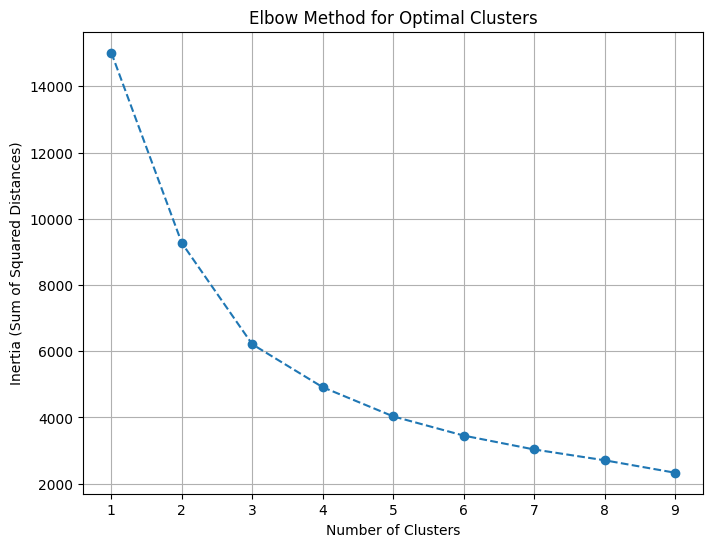

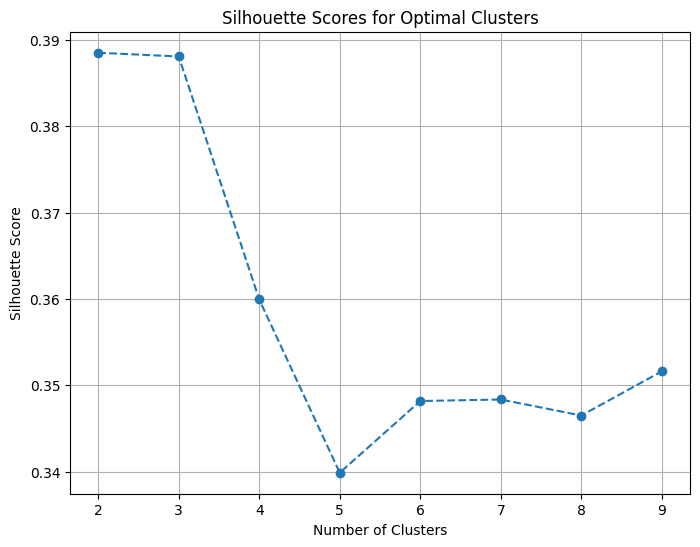

Cluster labels for each trial:
[2 1 2 ... 2 2 1]


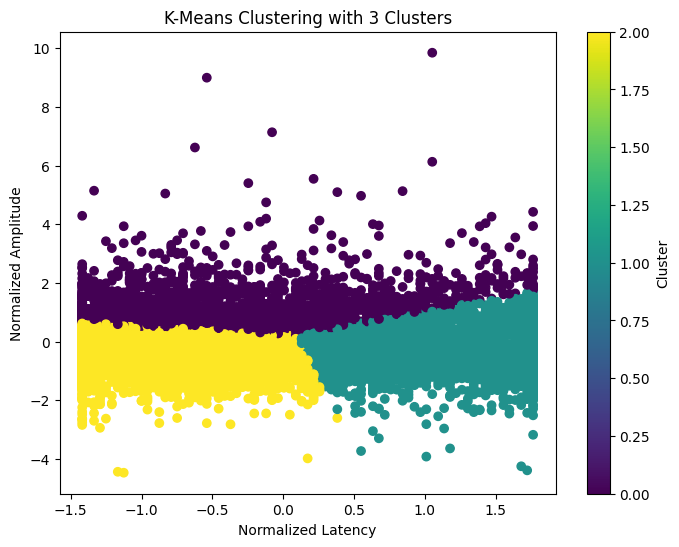

In [ ]:
import numpy as np
import scipy.io
from scipy.stats import zscore
import os
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Function to extract P300 features (latency and amplitude)
def extract_p300_features(eeg_data, channel_idx=25, fs=256, p300_window=(300, 600)):
    channel_idx = channel_idx - 1  # Convert 1-based index to 0-based index
    start_sample = int(p300_window[0] / 1000 * fs)
    end_sample = int(p300_window[1] / 1000 * fs)
    signal = eeg_data[:, channel_idx]
    latencies = []
    amplitudes = []
    n_trials = signal.shape[1]
    for trial_idx in range(n_trials):
        trial_signal = signal[:, trial_idx]
        p300_signal = trial_signal[start_sample:end_sample]
        p300_peak_idx = np.argmax(p300_signal)
        latency = (p300_peak_idx + start_sample) / fs
        amplitude = np.max(p300_signal)
        latencies.append(latency)
        amplitudes.append(amplitude)
    return np.array(latencies), np.array(amplitudes)

# Directory containing the participant files
directory_path = '/content/drive/MyDrive/EEG_dataset/splitset'

# List all files in the directory
files_in_directory = os.listdir(directory_path)

# Filter out the files that contain 'train' in their name
train_files = [file for file in files_in_directory if 'train' in file]

# Initialize lists to store latencies and amplitudes for all trials
all_latencies = []
all_amplitudes = []

# Loop through each train file in the directory
for file_name in train_files:
    file_path = os.path.join(directory_path, file_name)
    print(f"Loading file: {file_path}")
    eeg_data = scipy.io.loadmat(file_path)
    eeg_data = eeg_data['train_data']
    print(f"EEG data shape for {file_name}: {eeg_data.shape}")
    latencies, amplitudes = extract_p300_features(eeg_data, channel_idx=25, fs=256)
    all_latencies.append(latencies)
    all_amplitudes.append(amplitudes)

# Combine all latencies and amplitudes from all participants/trials
all_latencies = np.concatenate(all_latencies)
all_amplitudes = np.concatenate(all_amplitudes)

# Normalize the features using Z-score
latencies_zscore = zscore(all_latencies)
amplitudes_zscore = zscore(all_amplitudes)

# Prepare the feature matrix
feature_matrix = np.column_stack([latencies_zscore, amplitudes_zscore])

# Elbow Method to find the optimal number of clusters
inertia_values = []
range_clusters = range(1, 10)
for n_clusters in range_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(feature_matrix)
    inertia_values.append(kmeans.inertia_)

# Plot Elbow Method
plt.figure(figsize=(8, 6))
plt.plot(range_clusters, inertia_values, marker='o', linestyle='--')
plt.title("Elbow Method for Optimal Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Inertia (Sum of Squared Distances)")
plt.xticks(range_clusters)
plt.grid()
plt.show()

# Silhouette Scores to evaluate clustering quality
silhouette_values = []
range_clusters = range(2, 10)
for n_clusters in range_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(feature_matrix)
    silhouette_avg = silhouette_score(feature_matrix, cluster_labels)
    silhouette_values.append(silhouette_avg)

# Plot Silhouette Scores
plt.figure(figsize=(8, 6))
plt.plot(range_clusters, silhouette_values, marker='o', linestyle='--')
plt.title("Silhouette Scores for Optimal Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.xticks(range_clusters)
plt.grid()
plt.show()

# Choose the optimal number of clusters based on the above analysis
optimal_clusters = 3  # Update this based on Elbow and Silhouette results
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
kmeans.fit(feature_matrix)

# Get cluster labels for each trial
cluster_labels = kmeans.labels_

# Print the cluster labels
print("Cluster labels for each trial:")
print(cluster_labels)

# Visualize the clustering result
plt.figure(figsize=(8, 6))
plt.scatter(latencies_zscore, amplitudes_zscore, c=cluster_labels, cmap='viridis', marker='o')
plt.title(f"K-Means Clustering with {optimal_clusters} Clusters")
plt.xlabel("Normalized Latency")
plt.ylabel("Normalized Amplitude")
plt.colorbar(label="Cluster")
plt.show()
